This script generates the following materials for [Self-organizing actin networks drive sequential endocytic protein recruitment and vesicle release on synthetic lipid bilayers](https://www.pnas.org/doi/10.1073/pnas.2302622120):
- Figure 2D: sequential recruitment of Bzz1-GFP followed by Sac6-RFP
- Figure 3: reconstitution of actin-mediated vesicle budding
  - Figure 3A: montage of single budding event
  - Figure 3B: quantification trace of budding in 5a
  - Figure 3C: average quantification for all tracks
- Movie S1: 3D rendering of actin tail assembled on scWASP-coated bilayer
- Movie S2: time-lapse and 3D rendering of sequential recruitment of endocytic proteins to scWASP-coated supported bilayers
- Movies S3-S4: 3D rendering of vesicle embedded in actin tail
- Movies S5-S8: 3D rendering of actin-mediated vesicle budding from supported lipid bilayer
- Supplemental Figure S4: additional individual vesiculation montage and quantifications
- Supplemental Figure S5: individual vesiculation traces for inflection point calculation
- Figure 4E: CLEM vesicle quantification

To install necessary packages: `pip install -r requirements.txt`

Raw data should be downloaded from [Drubin/Barnes lab Google Drive](link_here) into the `data/` directory in order to reproduce the analyses in the jupyter notebook.

# Import libraries and set global parameters

In [1]:
%gui qt
from nd2reader import ND2Reader
import napari
from naparimovie import Movie

%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.gridspec as gridspec

SMALL_SIZE = 16
MEDIUM_SIZE = 18
BIGGER_SIZE = 24

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=MEDIUM_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

plt.rcParams['svg.fonttype'] = 'none'

import os
import pandas as pd
import numpy as np
from skimage import io
import skvideo.io 
from dask_image.imread import imread
from scipy import stats

#from custom_functions import nd2_metadata, movie_3d, findInflectionPoint

In [2]:
%gui qt

# Define functions

## Reading microscopy metadata

In [3]:
def nd2_metadata(imported_nd2, trackmate_z_spacing=0.5, trackmate_micron_per_px=0.1405):
    min_z = np.min(imported_nd2.metadata['z_coordinates'])
    max_z = np.max(imported_nd2.metadata['z_coordinates'])
    z_range = max_z - min_z
    z_slices = np.max(imported_nd2.metadata['z_levels'])+1
    z_spacing = z_range/z_slices
    micron_per_px = imported_nd2.metadata['pixel_microns']
    num_frames = imported_nd2.metadata['num_frames']
    s_per_frame = imported_nd2.metadata['experiment']['loops'][0]['sampling_interval']/1000
    s_total = imported_nd2.timesteps[-1]/1000
    s_timestamps = np.arange(num_frames)*s_per_frame
    
    metadata_dict = {
    'channel':imported_nd2.metadata['channels'],
#    'frames':imported_nd2.metadata['frames'],
    'num_frames':num_frames,
    's_per_frame':s_per_frame,
    's_total':s_total,
#    's_timestamps':s_timestamps,
    'micron_per_px':micron_per_px,
    'min_z':min_z,
    'max_z':max_z,
    'z_range':max_z - min_z,
    'z_slices':z_slices,
    'z_spacing':z_spacing,
    'trackmate_z_ratio':z_spacing/trackmate_z_spacing,
    'trackmate_xy_ratio':micron_per_px/trackmate_micron_per_px}
    
    #metadata = pd.DataFrame(metadata_dict).set_index('channel')
    
    return metadata_dict

## Visualizing and making movies with Napari

### Add 3D scale bar

In [4]:
# origin: [z,y,x] in µm
# scale_size: [z,y,x] in µm
def add_scale_3d(viewer, origin=[0,0,0], scale_size=[5,5,5], scale_width=0.2, color='white'):
    scale_size_z, scale_size_y, scale_size_x = scale_size
    origin_z, origin_y, origin_x = origin
    
    scale_bar_z = [[origin_z,origin_y,origin_x],[origin_z+scale_size_z,origin_y,origin_x]]
    scale_bar_y = [[origin_z,origin_y,origin_x],[origin_z,origin_y+scale_size_y,origin_x]]
    scale_bar_x = [[origin_z,origin_y,origin_x],[origin_z,origin_y,origin_x+scale_size_x]]
    
    viewer.add_shapes(scale_bar_x, shape_type='path', edge_width=scale_width,
                      face_color=color, edge_color=color)
    viewer.add_shapes(scale_bar_y, shape_type='path', edge_width=scale_width,
                      face_color=color, edge_color=color)
    viewer.add_shapes(scale_bar_z, shape_type='path', edge_width=scale_width,
                      face_color=color, edge_color=color)

### Add 3D timestamp

In [5]:
def add_timestamp_3d(viewer, raw_stack, s_timestamps, origin=[0,0,0]):
    time_labels = np.full((len(s_timestamps),4),0.)
    time_labels[:,0] = np.arange(len(s_timestamps))
    time_labels[:,1:] = origin

    properties = {'minutes':s_timestamps//60,
                 'seconds':np.round((s_timestamps/60-s_timestamps//60)*60)}
    text = {'text': '{minutes:n}:{seconds:n} (min:sec)', 
            'color':'white',
    #        'translation': [[0,-40,-40]],
            'size': 20
           }
    viewer.add_points(time_labels, properties=properties, text=text, 
                      face_color='transparent', edge_color='transparent',
                     blending='additive')

### generic 3D movie function

In [6]:
def movie_3d(stack, channels_list, vis_params, points=None, traj=None,
             z_low=None, z_high=None, y_low=None, y_high=None, x_low=None, x_high=None,
             script=None, movie_name='default_movie', 
             merge=True, separate=True, close_window=True):
    if merge == True:
        viewer = napari.Viewer(ndisplay=3)

        for channel in channels_list:
            vis_channel = vis_params.loc[channel]
            stack_channel = stack[...,vis_channel['stack_index']]
            if z_low and z_high:
                new_stack_channel = np.zeros_like(stack_channel)
                new_stack_channel[:,z_low:z_high,...] = stack_channel[:,z_low:z_high,...]
                stack_channel = new_stack_channel
            scale_channel = [1,vis_channel['z_spacing'],
                             vis_channel['micron_per_px'],
                             vis_channel['micron_per_px']]
            scale_trackmate = [1,vis_channel['micron_per_px'],
                              vis_channel['micron_per_px'],
                              vis_channel['micron_per_px']]

            viewer.add_image(stack_channel, colormap=vis_channel['color'],
                         name=vis_channel['label'], scale=scale_channel,
                         contrast_limits=vis_channel['contrast'], blending='additive')
            
        if type(points) != type(None):
            viewer.add_points(points, face_color='#ffffff00', edge_color='white', 
                  size=5, edge_width=0.1, opacity=0.7, 
                scale=scale_trackmate, symbol='disc', name='vesicle')

        if type(traj) != type(None):
            viewer.add_shapes(traj, shape_type='path', edge_color='white',
                              name='track', scale=scale_trackmate[1:],
                  edge_width=0.5, opacity = 0.7)

        if script:
            viewer.dims.current_step=(0,0,0,0)
            movie = Movie(myviewer=viewer)
            movie.create_state_dict_from_script(script)
            movie.make_movie(name = 'movies/'+movie_name+'_merge.mp4',
                             resolution = 320, fps = 20)
        if close_window == True:
            viewer.close()
    
    if separate == True:
        for channel in channels_list:
            viewer = napari.Viewer(ndisplay=3)
            vis_channel = vis_params.loc[channel]
            stack_channel = stack[...,vis_channel['stack_index']]
            if z_low and z_high:
                new_stack_channel = np.zeros_like(stack_channel)
                new_stack_channel[:,z_low:z_high,...] = stack_channel[:,z_low:z_high,...]
                stack_channel = new_stack_channel
            scale_channel = [1,vis_channel['z_spacing'],
                             vis_channel['micron_per_px'],
                             vis_channel['micron_per_px']]
            scale_trackmate = [1,vis_channel['micron_per_px'],
                              vis_channel['micron_per_px'],
                              vis_channel['micron_per_px']]

            viewer.add_image(stack_channel, 
                         name=vis_channel['label'], scale=scale_channel,
                         contrast_limits=vis_channel['contrast'], blending='additive')

            if type(points) != type(None):
                viewer.add_points(points, face_color='#ffffff00', edge_color='red', 
                      size=5, edge_width=0.1, opacity=0.7, scale=scale_trackmate,
                      symbol='disc', name='vesicle')
                
            if type(traj) != type(None):
                viewer.add_shapes(traj, shape_type='path', edge_color='yellow',
                                  name='track', scale=scale_trackmate[1:],
                      edge_width=0.5, opacity = 0.7)

            if script:
                viewer.dims.current_step=(0,0,0,0)
                movie = Movie(myviewer=viewer)
                movie.create_state_dict_from_script(script)
                movie.make_movie(name = 'movies/'+movie_name+'_'+vis_channel['label']+'.mp4',
                                 resolution = 320, fps = 20)
            if close_window == True:
                viewer.close()

### 3D movie with annotations function

In [7]:
def movie_3d_annotated(stack, channels_list, vis_params, points=None, points_size=5, traj=None,
             z_low=None, z_high=None, y_low=None, y_high=None, x_low=None, x_high=None,
             script=None, movie_name='default_movie', 
             merge=True, separate=True, close_window=True,
             scale_bar=False,
             scale_origin=[0,0,0], scale_size=[5,5,5], scale_width=0.2, scale_color='white',
             timestamps=False,
             time_origin=[0,0,0], raw_stack=None, s_timestamps=None):
    if merge == True:
        viewer = napari.Viewer(ndisplay=3)

        for channel in channels_list:
            vis_channel = vis_params.loc[channel]
            stack_channel = stack[...,vis_channel['stack_index']]
            if z_low and z_high:
                new_stack_channel = np.zeros_like(stack_channel)
                new_stack_channel[:,z_low:z_high,...] = stack_channel[:,z_low:z_high,...]
                stack_channel = new_stack_channel
            scale_channel = [1,vis_channel['z_spacing'],
                             vis_channel['micron_per_px'],
                             vis_channel['micron_per_px']]
            scale_trackmate = [1,vis_channel['micron_per_px'],
                              vis_channel['micron_per_px'],
                              vis_channel['micron_per_px']]

            viewer.add_image(stack_channel, colormap=vis_channel['color'],
                         name=vis_channel['label'], scale=scale_channel,
                         contrast_limits=vis_channel['contrast'], blending='additive')
            
        if type(points) != type(None):
            viewer.add_points(points, face_color='#ffffff00', edge_color='white', 
                  size=points_size, edge_width=0.1, opacity=0.7, scale=scale_trackmate,
                  symbol='disc', name='vesicle')

        if type(traj) != type(None):
            viewer.add_shapes(traj, shape_type='path', edge_color='white',
                              name='track', scale=scale_trackmate[1:],
                  edge_width=0.5, opacity = 0.7)
            
        if scale_bar == True:
            add_scale_3d(viewer, origin=scale_origin, scale_size=scale_size,
                        scale_width=scale_width, color=scale_color)
            
        if timestamps == True:
            add_timestamp_3d(viewer, raw_stack=raw_stack, s_timestamps=s_timestamps,
                            origin=time_origin)

        if script:
            viewer.dims.current_step=(0,0,0,0)
            movie = Movie(myviewer=viewer)
            movie.create_state_dict_from_script(script)
            movie.make_movie(name = 'movies/'+movie_name+'_merge.mp4',
                             resolution = 320, fps = 20)
        if close_window == True:
            viewer.close()
    
    if separate == True:
        for channel in channels_list:
            viewer = napari.Viewer(ndisplay=3)
            vis_channel = vis_params.loc[channel]
            stack_channel = stack[...,vis_channel['stack_index']]
            if z_low and z_high:
                new_stack_channel = np.zeros_like(stack_channel)
                new_stack_channel[:,z_low:z_high,...] = stack_channel[:,z_low:z_high,...]
                stack_channel = new_stack_channel
            scale_channel = [1,vis_channel['z_spacing'],
                             vis_channel['micron_per_px'],
                             vis_channel['micron_per_px']]
            scale_trackmate = [1,vis_channel['micron_per_px'],
                              vis_channel['micron_per_px'],
                              vis_channel['micron_per_px']]

            viewer.add_image(stack_channel, 
                         name=vis_channel['label'], scale=scale_channel,
                         contrast_limits=vis_channel['contrast'], blending='additive')

            if type(points) != type(None):
                viewer.add_points(points, face_color='#ffffff00', edge_color='red', 
                      size=points_size, edge_width=0.1, opacity=0.7, scale=scale_trackmate,
                      symbol='disc', name='vesicle')
                
            if type(traj) != type(None):
                viewer.add_shapes(traj, shape_type='path', edge_color='yellow',
                                  name='track', scale=scale_trackmate[1:],
                      edge_width=0.5, opacity = 0.7)

            if scale_bar == True:
                add_scale_3d(viewer, origin=scale_origin, scale_size=scale_size,
                            scale_width=scale_width, color=scale_color)

            if timestamps == True:
                add_timestamp_3d(viewer, raw_stack=raw_stack, s_timestamps=s_timestamps,
                                origin=time_origin)

            if script:
                viewer.dims.current_step=(0,0,0,0)
                movie = Movie(myviewer=viewer)
                movie.create_state_dict_from_script(script)
                movie.make_movie(name = 'movies/'+movie_name+'_'+vis_channel['label']+'.mp4',
                                 resolution = 320, fps = 20)
            if close_window == True:
                viewer.close()

## Calculate inflection point

borrowed from [Sun et al. 2019](https://doi.org/10.7554/eLife.50749)

In [8]:
def findInflectionPoint(x,y,debug=False):
    # this function calculates the point where the function has a kink and returns the index of that point
    x = x.loc[:np.argmax(y)]
    y = y.loc[:np.argmax(y)]
    slope, intercept, r, prob2, see = stats.linregress(x, y)
    mx = x.mean()
    sx2 = ((x-mx)**2).sum()
    sd_intercept = see * np.sqrt(1./len(x) + mx*mx/sx2)
    sd_slope = see * np.sqrt(1./sx2)

    inter_slope_intercept = [slope,sd_slope,intercept,sd_intercept]

    if debug == True:
        f, ax = plt.subplots()
        ax.plot(x, y, 'o', label='original data',color='b')
        ax.plot(x, intercept + slope*x, 'r', label='fitted line')
        plt.xlabel('time (min)')
        plt.ylabel('displacement (µm)')
        print("slope={}±{}, intercept={}±{}, r={}, prob2={}, see={}".format(slope,sd_slope, intercept,sd_intercept, r, prob2, see))
    

# find the inflection point

    newy = y-(intercept+slope*x)
    posdiff = newy.loc[y > np.max(y)*0.5]
    #newy = np.array(newy)
    #inflectionPoint = np.min(newy)
    peak = posdiff.idxmax()
    inflectionPointIndex = np.argmin(newy.loc[:peak])
    inflectionPointIndex = newy.loc[:peak].idxmin()
    
    if debug == True:
        ax.vlines(x[inflectionPointIndex], min(y), max(y), label='inflection')
        ax.legend()
        #plt.show()
        return(ax)
    else:
        return(inflectionPointIndex)

# Image processing for Figure 2D

## Set paths to data

In [9]:
crop_tiff = 'data/4.4.5M1002_bs_bcexp_bead2_dc.tif'
raw_nd2 = 'data/4.4.5M1002.nd2'

## Read processed single bead crop

In [10]:
crop = io.imread(crop_tiff)
crop.shape

(52, 68, 88, 80, 3)

## Read raw data corresponding to processed stack

In [11]:
raw = ND2Reader(raw_nd2)
raw.bundle_axes = 'czyx'
raw

<FramesSequenceND>
Axes: 5
Axis 'x' size: 512
Axis 'y' size: 512
Axis 'c' size: 3
Axis 't' size: 52
Axis 'z' size: 58
Pixel Datatype: <class 'numpy.float64'>

## Read metadata from raw data

In [12]:
raw_metadata = nd2_metadata(raw)

## Manually set visualization parameters, combine with metadata

In [78]:
channel_names = {'sac6':'Confocal 561 2',
                'bzz1':'Confocal 488',
                'dope':'Confocal 638'}
contrast = {'sac6':(1650,1950),
            'bzz1':(300,1000),
            'dope':(550,900)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
#labels = {'sac6':'Sac6-RFP',
#        'bzz1':'Bzz1-GFP',
#        'dope':'ATTO647-DOPE',
#         'merge':'Merge'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE'}

vis_params = pd.DataFrame({'channel':channel_names,
             'contrast':contrast,
             'color':colors,
             'label':labels}).set_index('channel')
channel_order = {'stack_index':{}}
for i, channel in enumerate(raw_metadata['channel']):
    channel_order['stack_index'][channel] = i

vis_params = pd.concat([vis_params,pd.DataFrame(channel_order),
                       pd.DataFrame(raw_metadata).set_index('channel')],axis=1)

# hack to add merge visualization
vpm = vis_params.loc[vis_params.index[0]].copy()
vpm['label'] = 'Merge'
vpm['color'] = 'black'
vis_params.loc['Merge'] = vpm

vis_params

,contrast,color,label,stack_index,num_frames,s_per_frame,s_total,micron_per_px,min_z,max_z,z_range,z_slices,z_spacing,trackmate_z_ratio,trackmate_xy_ratio
Confocal 561 2,"(1650, 1950)",magenta,Sac6-RFP,0,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.39569,0.999763
Confocal 488,"(300, 1000)",green,Bzz1-GFP,1,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.39569,0.999763
Confocal 638,"(550, 900)",cyan,ATTO647-DOPE,2,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.39569,0.999763
Merge,"(1650, 1950)",black,Merge,0,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.39569,0.999763


In [79]:
# I couldn't work this one into the dataframe
num_frames = vis_params['num_frames'][0]
s_per_frame = vis_params['s_per_frame'][0]
s_per_frame = vis_params['s_total'][0]/num_frames
s_timestamps = np.arange(num_frames)*s_per_frame+(80*60)

## Make simple montage

### write movie script

rotation is around x-axis (upward), around z in-plane (clockwise), around y-axis (leftward)

In [15]:
tl_frames = crop.shape[0]-1
with open("movies/3b_movie_script.txt", "w") as text_file:
    print('From frame 0 to frame 0\n'
    '-rotate by 310 degrees around (1,0,0)\n'
    '-rotate by 40 degrees around (0,1,0)\n'
    f'From frame 0 to frame {tl_frames}\n'
    f'-shift time by {tl_frames}', file=text_file)

### Record movies in napari

#### sac6 and bzz1, merged and separate

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  command_list = np.array(command_list)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:193: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  current_state = copy.deepcopy(movie.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\numpy\core\fromnumeric.py:86: Visible

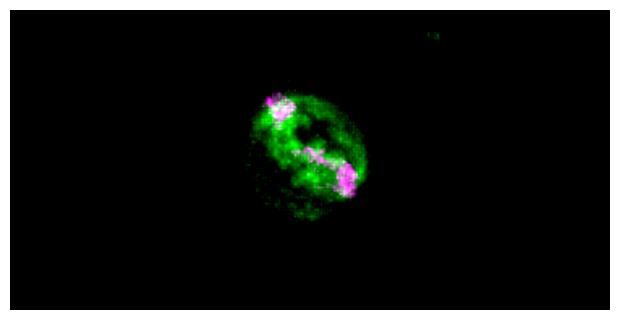

MovieWriter ffmpeg unavailable; using Pillow instead.
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3

ValueError: unknown file extension: .mp4

In [16]:
movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488'], vis_params=vis_params,
         script='movies/3b_movie_script.txt', movie_name='3b_movie_idk')

### Read movies

In [33]:
max_projections = {'Merge':skvideo.io.vread('movies/3b_movie_merge.mp4'),
                  'Confocal 561 2':skvideo.io.vread('movies/3b_movie_Sac6-RFP.mp4'),
                  'Confocal 488':skvideo.io.vread('movies/3b_movie_Bzz1-GFP.mp4')}
max_projections['Merge'].shape

(52, 960, 1620, 3)

### Make montage figure panel from movies

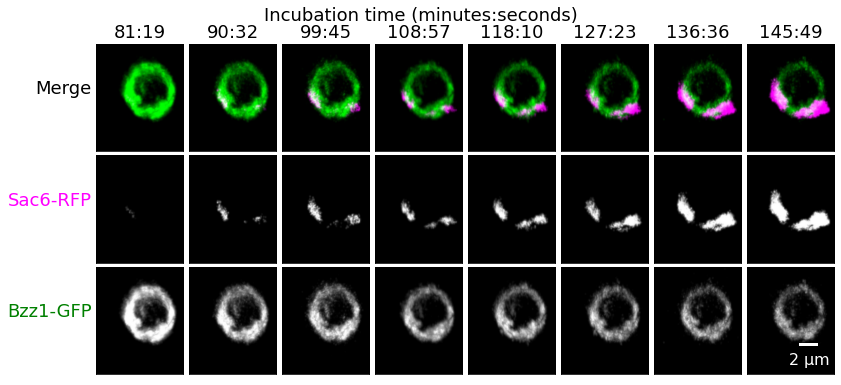

In [34]:
all_frames = raw.metadata['frames']
micron_per_px = raw.metadata['pixel_microns']
s_per_frame = vis_params.loc['Confocal 561 2']['s_per_frame']
frames = all_frames[1::7]
count = 0
width = 1.5*len(frames)
height = 0.45 * width
channels = ['Merge','Confocal 561 2','Confocal 488']
fig = plt.figure(figsize=(width,height))

#fig.text(0.5,0.9,'Incubation time (minutes:seconds)',fontsize=MEDIUM_SIZE,ha='center')
fig.suptitle('Incubation time (minutes:seconds)', fontsize=MEDIUM_SIZE, y=1)

for channel in channels:
    for tp in frames:
        count += 1
        plt.subplot(len(channels),len(frames),count)
        plt.imshow(max_projections[channel][tp,160:960,400:1050])
        #plt.axis('off')
        ax = plt.gca()
        ax.axes.xaxis.set_ticks([])
        ax.axes.yaxis.set_ticks([])
        if channel == channels[0]:
            minutes = int(s_per_frame*tp//60)
            seconds = int(np.round((s_per_frame*tp/60-minutes)*60))
            plt.title(str(80+minutes)+':'+str(seconds))
        if tp == frames[0]:
            plt.ylabel(vis_params.loc[channel]['label'],
                       rotation=0,color=vis_params.loc[channel]['color'],
                       ha='right',)
        if count == len(frames)*len(channels):
            scalebar = ScaleBar(micron_per_px/10, 'um', box_alpha=0, color='w', 
                                length_fraction=0.4, height_fraction=0.02,
                               location='lower right')
            plt.gca().add_artist(scalebar)

plt.tight_layout(h_pad=0.02,w_pad=0.01)

plt.savefig('figures/3b_montage.svg')
plt.savefig('figures/3b_montage.png')

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

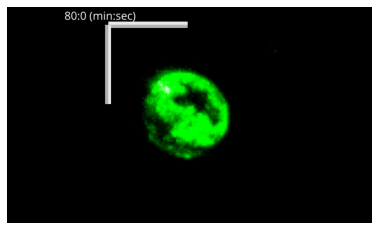

In [35]:
# calibration

tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/3b_rotation_annotated_movie_script_calibration.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
# rotation around x-axis (thumb style)
'-rotate by 300 degrees around (1,0,0)\n'
# rotation around z-axis
'-rotate by 50 degrees around (0,1,0)\n'
# rotation around y-axis
'-rotate by 10 degrees around (0,0,1)\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,1,0)', 
        file=text_file)
    
origin_z = vis_params['z_range'][0]
origin_y = 0
origin_x = 0
time_origin=[origin_z,origin_y,origin_x]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488'],
                   vis_params=vis_params, separate=False,
                   script='movies/3b_rotation_annotated_movie_script_calibration.txt', 
                   movie_name='3b_rotation_movie_annotated_calibration',
                   scale_bar=True,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps, time_origin=time_origin,
                  close_window=False)

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

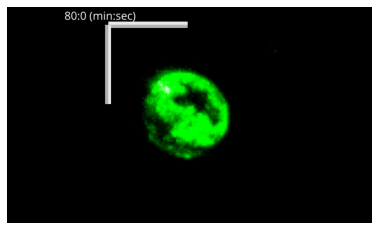

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

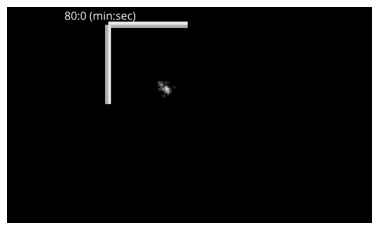

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

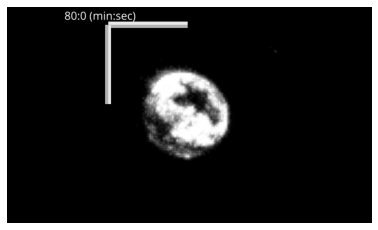

In [36]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/3b_rotation_annotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
# rotation around x-axis (thumb style)
'-rotate by 300 degrees around (1,0,0)\n'
# rotation around z-axis
'-rotate by 50 degrees around (0,1,0)\n'
# rotation around y-axis
'-rotate by 10 degrees around (0,0,1)\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,1,0)\n'
f'From frame {rotation_frames} to frame {rotation_frames+tl_delay} shift time by {tl_frames}\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames*2+tl_delay} rotate by 360 degrees around (0,1,0)\n'
f'From frame {rotation_frames*2+tl_delay} to frame {rotation_frames*2+tl_delay*2} shift time by {-tl_frames}', 
        file=text_file)
    
origin_z = vis_params['z_range'][0]
origin_y = 0
origin_x = 0
time_origin=[origin_z,origin_y,origin_x]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488'],
                   vis_params=vis_params,
                   script='movies/3b_rotation_annotated_movie_script.txt', 
                   movie_name='3b_rotation_movie_annotated',
                   scale_bar=True,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps, time_origin=time_origin)

## Make time lapse movie with 3D rotations

9/3/20: try replacing this section with new functions for scale/timestamp in napari (right above this)

rotation is around x-axis (upward), around z in-plane (clockwise), around y-axis (leftward)

In [37]:
#tl_frames = crop.shape[0]-1
#rotation_frames = 50
#with open("movies/3b_rotation_movie_script.txt", "w") as text_file:
#    print('From frame 0 to frame 0\n'
#    '-rotate by 310 degrees around (1,0,0)\n'
#    '-rotate by 40 degrees around (0,1,0)\n'
#    f'From frame 0 to frame {rotation_frames}\n'
#    '-rotate by 360 degrees around (0,1,0)\n'
#    f'From frame {rotation_frames} to frame {rotation_frames+tl_frames}\n'
#    f'-shift time by {tl_frames}\n'
#    f'From frame {rotation_frames+tl_frames} to frame {2*rotation_frames+tl_frames}\n'
#    '-rotate by 360 degrees around (0,1,0)', file=text_file)

In [38]:
#viewer = napari.Viewer(ndisplay=3)
#
#for i, channel in enumerate(['sac6','bzz1']):
#    crop_channel = crop[...,i]
#    
#    viewer.add_image(crop_channel, colormap=colors[channel],
#                 name=channel, scale=[1,z_spacing,micron_per_px,micron_per_px],
#                 contrast_limits=contrast[channel], blending='additive')
#    
#movie = Movie(myviewer=viewer)
#movie.create_state_dict_from_script('movies/3b_rotation_movie_script.txt')
#movie.make_movie(name = 'movies/3b_rotation_movie_merge.mp4', resolution = 320, fps = 20)

In [39]:
#movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488'], vis_params=vis_params,
#         script='movies/3b_rotation_movie_script.txt', movie_name='3b_rotation_movie')

### Read movie

In [40]:
rotation_movie = skvideo.io.vread('movies/3b_rotation_movie_merge.mp4')
rotation_movie.shape

(152, 960, 1504, 3)

### make timepoints to label movie

In [41]:
frames = range(crop.shape[0])
frame_labels = np.concatenate((np.zeros(rotation_frames),
                              np.array(frames),
                              np.full(rotation_frames,frames[-1])))
time_labels = frame_labels*s_per_frame/60+95

### label movie with timepoints and scale bar, save as tiffs

<ipython-input-42-1dfc82709cae>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(4,3))


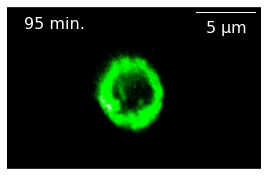

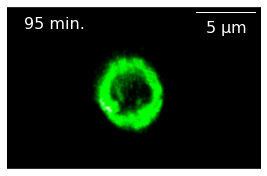

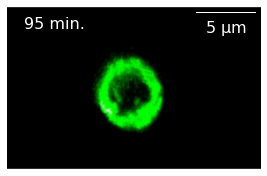

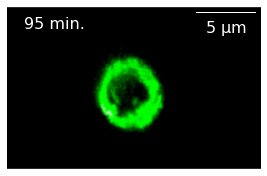

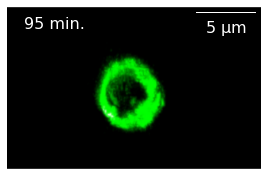

...

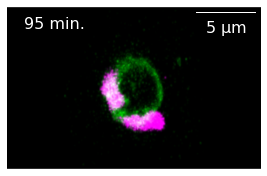

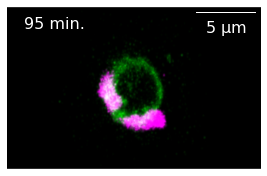

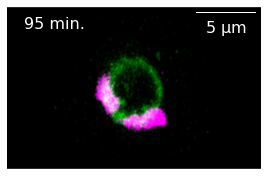

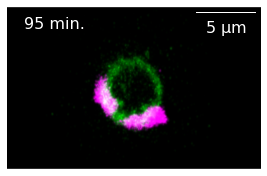

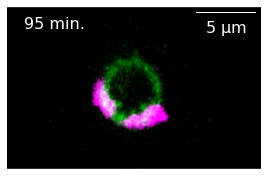

In [42]:
for frame in range(rotation_movie.shape[0]):
    plt.figure(figsize=(4,3))
    plt.imshow(rotation_movie[frame,...])
    plt.axis('off')
    plt.text(100,100,str(int(round(time_labels[frame])))+' min.', color='w', 
         horizontalalignment='left', verticalalignment='center')
    scalebar = ScaleBar(micron_per_px/10, 'um', box_alpha=0, color='w',
                length_fraction=0.4)
    plt.gca().add_artist(scalebar)
    plt.tight_layout()
    
    plt.savefig('figures/rotation_movie_allframes/'+str(frame)+'.tif')

### Encode tiffs to new video

In [43]:
stack = imread("figures/rotation_movie_allframes/*.tif")
skvideo.io.vwrite('movies/3b_rotation_movie_merge_labeled.avi', np.array(stack))
skvideo.io.vwrite('movies/3b_rotation_movie_merge_labeled.mov', np.array(stack))
skvideo.io.vwrite('movies/3b_rotation_movie_merge_labeled.mp4', np.array(stack))

# Image processing for figure 3A

## Set paths to data

In [96]:
crop_tiff = 'data/4.4.3M1001_bs_bcexp_bead1_dc.tif'
raw_nd2 = 'data/4.4.3M1001.nd2'
track_csv = 'tracks/4.4.3M1001_bs_bcexp_bead1_dc_trackmate.csv'

## Read processed single bead crop

In [97]:
crop = io.imread(crop_tiff)
crop.shape

(22, 23, 85, 76, 3)

## Read raw data corresponding to processed stack

In [98]:
raw = ND2Reader(raw_nd2)
raw.bundle_axes = 'czyx'
raw

<FramesSequenceND>
Axes: 5
Axis 'x' size: 512
Axis 'y' size: 512
Axis 'c' size: 3
Axis 't' size: 22
Axis 'z' size: 21
Pixel Datatype: <class 'numpy.float64'>

## Read metadata from raw data

In [100]:
raw_metadata = nd2_metadata(raw)

## Set visualization parameters

In [101]:
contrast = {'sac6':(575,2345),
            'bzz1':(170,310),
            'dope':(400,745)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE',
         'merge':'Merge'}
z_low, z_high = 9,13
y_low, y_high = 0,40
x_low, x_high = 18,56

## Manually set visualization parameters, combine with metadata

In [102]:
channel_names = {'sac6':'Confocal 561 2',
                'bzz1':'Confocal 488',
                'dope':'Confocal 638'}
contrast = {'sac6':(575,2345),
            'bzz1':(170,310),
            'dope':(400,745)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
#labels = {'sac6':'Sac6-RFP',
#        'bzz1':'Bzz1-GFP',
#        'dope':'ATTO647-DOPE',
#         'merge':'Merge'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE'}

vis_params = pd.DataFrame({'channel':channel_names,
             'contrast':contrast,
             'color':colors,
             'label':labels}).set_index('channel')
channel_order = {'stack_index':{}}
for i, channel in enumerate(raw_metadata['channel']):
    channel_order['stack_index'][channel] = i

vis_params = pd.concat([vis_params,pd.DataFrame(channel_order),
                       pd.DataFrame(raw_metadata).set_index('channel')],axis=1)

# hack to add merge visualization
vpm = vis_params.loc[vis_params.index[0]].copy()
vpm['label'] = 'Merge'
vpm['color'] = 'black'
vis_params.loc['Merge'] = vpm

#vis_params.loc['Merge'] = vis_params.loc[vis_params.index[0]].copy()
#vis_params.loc['Merge']['color'] = 'black'
#vis_params.loc['Merge']['label'] = 'Merge'
vis_params

,contrast,color,label,stack_index,num_frames,s_per_frame,s_total,micron_per_px,min_z,max_z,z_range,z_slices,z_spacing,trackmate_z_ratio,trackmate_xy_ratio
Confocal 561 2,"(575, 2345)",magenta,Sac6-RFP,0,22,0.0,1262.641326,0.140467,2146.9,2156.55,9.65,21,0.459524,0.919048,0.999763
Confocal 488,"(170, 310)",green,Bzz1-GFP,1,22,0.0,1262.641326,0.140467,2146.9,2156.55,9.65,21,0.459524,0.919048,0.999763
Confocal 638,"(400, 745)",cyan,ATTO647-DOPE,2,22,0.0,1262.641326,0.140467,2146.9,2156.55,9.65,21,0.459524,0.919048,0.999763
Merge,"(575, 2345)",black,Merge,0,22,0.0,1262.641326,0.140467,2146.9,2156.55,9.65,21,0.459524,0.919048,0.999763


In [103]:
# I couldn't work this one into the dataframe
num_frames = vis_params['num_frames'][0]
s_per_frame = vis_params['s_per_frame'][0]
s_per_frame = vis_params['s_total'][0]/num_frames
s_timestamps = np.arange(num_frames)*s_per_frame+(80*60)

## Read vesicle tracking data

In [104]:
trackmate_xy_ratio = vis_params['trackmate_xy_ratio'][0]
trackmate_z_ratio = vis_params['trackmate_z_ratio'][0]
micron_per_px = vis_params['micron_per_px'][0]
px_per_micron = 1/micron_per_px

track_df = pd.read_csv(track_csv)
frames = track_df['FRAME']
x = track_df['POSITION_X']*trackmate_xy_ratio*px_per_micron
y = track_df['POSITION_Y']*trackmate_xy_ratio*px_per_micron
z = track_df['POSITION_Z']*trackmate_z_ratio*px_per_micron
spots = np.transpose(np.array([frames,z,y,x]))
traj = np.transpose(np.array([z,y,x]))

## Make movies/montages

### full time lapse

#### write movie script

In [ ]:
tl_frames = crop.shape[0]-1
with open("movies/5a_movie_script.txt", "w") as text_file:
    print(
f'From frame 0 to frame {tl_frames} shift time by {tl_frames}', 
        file=text_file)

#### Record movies in napari

##### merge of sac6, bzz1, and lipid

In [ ]:
viewer = napari.Viewer(ndisplay=3)

for i, channel in enumerate(['sac6','bzz1','dope']):
    crop_channel = crop[...,i]
    
    viewer.add_image(crop_channel, colormap=colors[channel],
                 name=channel, scale=[1,z_scale,xy_scale,xy_scale],
                 contrast_limits=contrast[channel], blending='additive')
    
viewer.add_points(spots, face_color='#ffffff00', edge_color='white', 
                  size=5, edge_width=3, opacity=0.7,
                  symbol='disc', name='vesicle')
viewer.add_shapes(traj, shape_type='path', edge_color='red', name='track', 
                  edge_width=0.5, visible=False)

movie = Movie(myviewer=viewer)
movie.create_state_dict_from_script('movies/5a_movie_script.txt')
movie.make_movie(name = 'movies/5a_movie_merge.mp4', resolution = 320, fps = 20)

##### each channel separately

In [ ]:
for i, channel in enumerate(['sac6','bzz1','dope']):
    viewer = napari.Viewer(ndisplay=3)
    crop_channel = crop[...,i]
    
    viewer.add_image(crop_channel, colormap='gray',
                 name=channel, scale=[1,z_scale,xy_scale,xy_scale],
                 contrast_limits=contrast[channel], blending='additive')
    
    movie = Movie(myviewer=viewer)
    movie.create_state_dict_from_script('movies/5a_movie_script.txt')
    movie.make_movie(name = 'movies/5a_movie_'+channel+'_gray.mp4', resolution = 320, fps = 20)

### Narrower z-section time lapse

#### Record movies in napari

##### merge of sac6, bzz1, and lipid

In [ ]:
viewer = napari.Viewer(ndisplay=3)

for i, channel in enumerate(['sac6','bzz1','dope']):
    crop_channel = crop[...,i]
    crop_slice = np.zeros_like(crop_channel)
    crop_slice[:,z_low:z_high,...] = crop_channel[:,z_low:z_high,...]

    viewer.add_image(crop_slice, colormap=colors[channel],
                 name=channel, scale=[1,z_scale,xy_scale,xy_scale],
                 contrast_limits=contrast[channel], blending='additive')
    
viewer.add_points(spots, face_color='#ffffff00', edge_color='white', 
                  size=5, edge_width=3, opacity=0.7,
                  symbol='disc', name='vesicle')
viewer.add_shapes(traj, shape_type='path', edge_color='red', name='track', 
                  edge_width=0.5, visible=False)

movie = Movie(myviewer=viewer)
movie.create_state_dict_from_script('movies/5a_movie_script.txt')
movie.make_movie(name = 'movies/5a_movie_slice_merge.mp4', resolution = 320, fps = 20)

##### each channel separately

In [ ]:
for i, channel in enumerate(['sac6','bzz1','dope']):
    viewer = napari.Viewer(ndisplay=3)
    crop_channel = crop[...,i]
    crop_slice = np.zeros_like(crop_channel)
    crop_slice[:,z_low:z_high,...] = crop_channel[:,z_low:z_high,...]

    viewer.add_image(crop_slice, colormap='gray',
                 name=channel, scale=[1,z_scale,xy_scale,xy_scale],
                 contrast_limits=contrast[channel], blending='additive')
    
    movie = Movie(myviewer=viewer)
    movie.create_state_dict_from_script('movies/5a_movie_script.txt')
    movie.make_movie(name = 'movies/5a_movie_slice_'+channel+'_gray.mp4', resolution = 320, fps = 20)

#### Read movies

In [ ]:
max_projections = {'Merge':skvideo.io.vread('movies/5a_movie_slice_merge.mp4'),
                  'Confocal 561 2':skvideo.io.vread('movies/5a_movie_slice_sac6_gray.mp4'),
                  'Confocal 488':skvideo.io.vread('movies/5a_movie_slice_bzz1_gray.mp4'),
                  'Confocal 638':skvideo.io.vread('movies/5a_movie_slice_dope_gray.mp4')}
max_projections['Merge'].shape

### Narrower z-section time lapse with 3D rotation

#### write movie script

In [ ]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 50
with open("movies/5a_rotation_movie_script.txt", "w") as text_file:
    print(
'At frame 0 make layer 4 invisible\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames} to frame {rotation_frames+tl_delay} shift time by {tl_frames}\n'
f'At frame {rotation_frames+tl_delay} make layer 4 visible\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames+tl_delay*2} shift time by -{tl_frames}\n'
f'From frame {rotation_frames+tl_delay*2} to frame {rotation_frames*2+tl_delay*2} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay*2} to frame {rotation_frames*2+tl_delay*3} shift time by {tl_frames}', 
        file=text_file)

#### Record movies in napari

##### merge of sac6, bzz1, and lipid

In [ ]:
viewer = napari.Viewer(ndisplay=3)

for i, channel in enumerate(['sac6','bzz1','dope']):
    crop_channel = crop[...,i]
    crop_slice = np.zeros_like(crop_channel)
    crop_slice[:,z_low:z_high,...] = crop_channel[:,z_low:z_high,...]

    viewer.add_image(crop_slice, colormap=colors[channel],
                 name=channel, scale=[1,z_scale,xy_scale,xy_scale],
                 contrast_limits=contrast[channel], blending='additive')
    
viewer.add_points(spots, face_color='#ffffff00', edge_color='white', 
                  size=5, edge_width=3, opacity=0.7,
                  symbol='disc', name='vesicle')
viewer.add_shapes(traj, shape_type='path', edge_color='red', name='track', edge_width=0.5)

movie = Movie(myviewer=viewer)
movie.create_state_dict_from_script('movies/5a_rotation_movie_script.txt')
movie.make_movie(name = 'movies/5a_rotation_movie_slice_merge.mp4', resolution = 320, fps = 20)

In [95]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/5a_rotation_annotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
# rotation around x-axis (thumb style)
#'-rotate by 300 degrees around (1,0,0)\n'
# rotation around z-axis
#'-rotate by 50 degrees around (0,1,0)\n'
# rotation around y-axis
#'-rotate by 10 degrees around (0,0,1)\n'
'At frame 0 make layer 4 invisible\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames} to frame {rotation_frames+tl_delay} shift time by {tl_frames}\n'
f'At frame {rotation_frames+tl_delay} make layer 4 visible\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames+tl_delay*2} shift time by -{tl_frames}\n'
f'From frame {rotation_frames+tl_delay*2} to frame {rotation_frames*2+tl_delay*2} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay*2} to frame {rotation_frames*2+tl_delay*3} shift time by {tl_frames}', 
        file=text_file)

In [ ]:
origin_z = vis_params['z_range'][0]
origin_y = crop.shape[2]*vis_params['micron_per_px'][0]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]

movie_3d_annotated(stack=crop, channels_list=['Confocal 638', 'Confocal 561 2', 'Confocal 488'],
                   vis_params=vis_params, z_low=z_low, z_high=z_high,
                   points=spots, traj=traj,
                   script='movies/5a_rotation_annotated_movie_script.txt', 
                   movie_name='5a_rotation_movie_annotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=[-5,-5,5],
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps)

###### 3d rotation halfway through with trajectory appearing

In [106]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s5_rotation_advannotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
# rotation around x-axis (thumb style)
#'-rotate by 300 degrees around (1,0,0)\n'
# rotation around z-axis
#'-rotate by 50 degrees around (0,1,0)\n'
# rotation around y-axis
#'-rotate by 10 degrees around (0,0,1)\n'
'At frame 0 make layer 4 invisible\n'
f'From frame 0 to frame {tl_delay} shift time by {tl_frames}\n'
f'At frame {tl_delay} make layer 4 visible\n'
f'From frame {tl_delay} to frame {rotation_frames+tl_delay} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames+tl_delay*2} shift time by -{tl_frames}\n'
f'From frame {rotation_frames+tl_delay*2} to frame {rotation_frames*2+tl_delay*2} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay*2} to frame {rotation_frames*2+tl_delay*3} shift time by {tl_frames}', 
        file=text_file)

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  command_list = np.array(command_list)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:193: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  current_state = copy.deepcopy(movie.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\numpy\core\fromnumeric.py:86: Visible

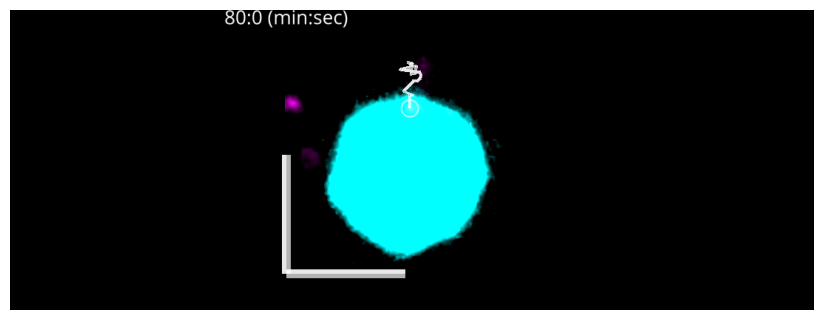

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

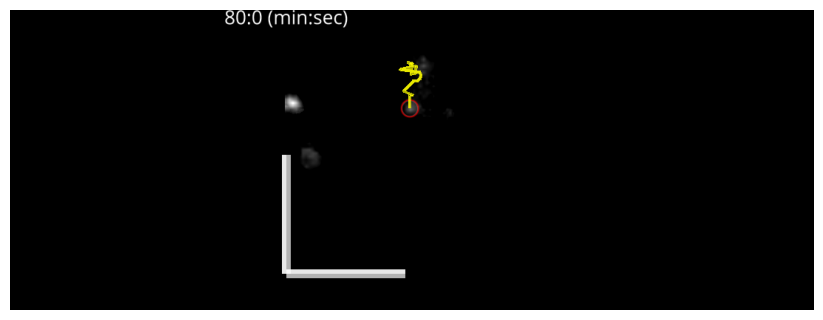

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

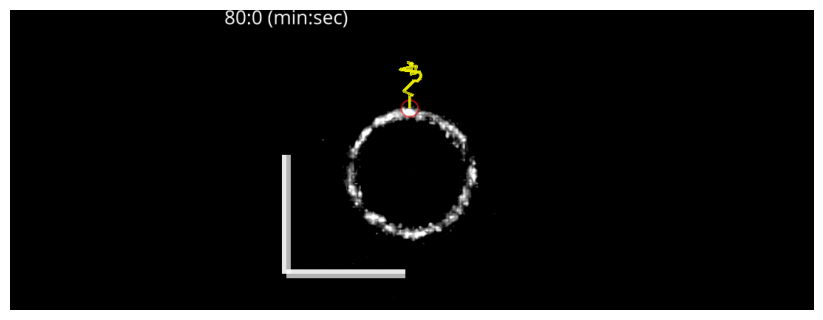

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

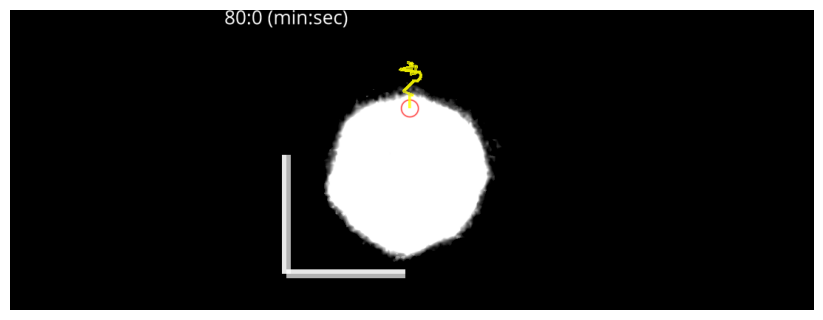

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

In [107]:
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj, z_low=z_low, z_high=z_high,
                   script='movies/s5_rotation_advannotated_movie_script.txt', 
                   movie_name='s5_rotation_spots_traj_movie_advannotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps, 
                  close_window=False)

# Vesicle track analysis for figure 3B-C

## Make list of vesicle tracks

In [45]:
tracks_filenames = []

for f in os.listdir('tracks/'):
    if f.endswith('.csv'):
        tracks_filenames.append(f)
        
tracks_filenames

['4.4.2B1.2_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead2_dc_trackmate.csv',
 '4.4.4M1003_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead2_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead4_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead5_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead6_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead3_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead4_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead5_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead4.1_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead4.2_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead6_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead7_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead8_dc_trackmate.csv',
 '4.4.5M1002_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead7_dc_trackmate.csv',
 '4.4.3M1001_bs_bcexp_bead1_dc_trackmate.csv']

## Read tracks into dataframes and organize in a dictionary

In [46]:
beads_dict = {}

for f in tracks_filenames:
    bead_df = pd.read_csv('tracks/'+f)
    beads_dict[f] = bead_df
    
list(beads_dict)

['4.4.2B1.2_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead2_dc_trackmate.csv',
 '4.4.4M1003_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead2_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead4_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead5_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M1001_bs_bcexp_bead6_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead3_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead4_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead5_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead4.1_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead4.2_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead6_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead7_dc_trackmate.csv',
 '4.4.4M1002_bs_bcexp_bead8_dc_trackmate.csv',
 '4.4.5M1002_bs_bcexp_bead1_dc_trackmate.csv',
 '4.4.4M2003_bs_bcexp_bead7_dc_trackmate.csv',
 '4.4.3M1001_bs_bcexp_bead1_dc_trackmate.csv']

## Separate out tracks from same bead

In [47]:
tracks_dict = {}

for d in beads_dict:
    track_ids = np.unique(beads_dict[d]['TRACK_ID'])
    for track in track_ids:
        track_name = d + '_track' + str(track)
        tracks_dict[track_name] = beads_dict[d][beads_dict[d]['TRACK_ID'] == track]
        
list(tracks_dict)

['4.4.2B1.2_bs_bcexp_bead1_dc_trackmate.csv_track1',
 '4.4.4M1002_bs_bcexp_bead2_dc_trackmate.csv_track0',
 '4.4.4M1003_bs_bcexp_bead1_dc_trackmate.csv_track0',
 '4.4.4M1001_bs_bcexp_bead1_dc_trackmate.csv_track0',
 '4.4.4M1001_bs_bcexp_bead2_dc_trackmate.csv_track0',
 '4.4.4M1001_bs_bcexp_bead4_dc_trackmate.csv_track0',
 '4.4.4M1001_bs_bcexp_bead4_dc_trackmate.csv_track2',
 '4.4.4M1001_bs_bcexp_bead5_dc_trackmate.csv_track0',
 '4.4.4M2003_bs_bcexp_bead1_dc_trackmate.csv_track0',
 '4.4.4M2003_bs_bcexp_bead1_dc_trackmate.csv_track1',
 '4.4.4M1001_bs_bcexp_bead6_dc_trackmate.csv_track0',
 '4.4.4M1001_bs_bcexp_bead6_dc_trackmate.csv_track1',
 '4.4.4M2003_bs_bcexp_bead3_dc_trackmate.csv_track0',
 '4.4.4M2003_bs_bcexp_bead4_dc_trackmate.csv_track0',
 '4.4.4M2003_bs_bcexp_bead4_dc_trackmate.csv_track1',
 '4.4.4M2003_bs_bcexp_bead4_dc_trackmate.csv_track2',
 '4.4.4M2003_bs_bcexp_bead4_dc_trackmate.csv_track3',
 '4.4.4M2003_bs_bcexp_bead4_dc_trackmate.csv_track4',
 '4.4.4M1002_bs_bcexp_bead1_d

## Calculate vesicle displacement by distance from initial position

In [48]:
for track in tracks_dict:
    df = tracks_dict[track]
    initial_x_0 = df[df['FRAME'] == 0]['POSITION_X']
    initial_y_0 = df[df['FRAME'] == 0]['POSITION_Y']
    initial_z_0 = df[df['FRAME'] == 0]['POSITION_Z']

    disp_x_0 = df['POSITION_X'] - float(initial_x_0)
    disp_y_0 = df['POSITION_Y'] - float(initial_y_0)
    disp_z_0 = df['POSITION_Z'] - float(initial_z_0)

    disp_3d_0 = np.sqrt(disp_x_0**2 + disp_y_0**2 + disp_z_0**2)

    df['DISPLACEMENT'] = disp_3d_0

C:\Users\Nice\AppData\Local\Temp\ipykernel_7848\1962591323.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['DISPLACEMENT'] = disp_3d_0
C:\Users\Nice\AppData\Local\Temp\ipykernel_7848\1962591323.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['DISPLACEMENT'] = disp_3d_0
C:\Users\Nice\AppData\Local\Temp\ipykernel_7848\1962591323.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

## Supplemental figure S5: Show how inflection points are calculated

slope=0.06413287586150629±0.00043807974815562417, intercept=-0.17781391437943606±0.003800900623623486, r=0.917104649893881, prob2=1.501483428349594e-06, see=0.007731755979199534
slope=0.00688738437041544±8.564062974346777e-06, intercept=-0.025024065771245246±0.00024398868452826247, r=0.5040448445197557, prob2=1.4144156285761904e-07, see=0.0012108070424120766
slope=0.18151204882333136±0.00029562679053014623, intercept=-0.6455772573366485±0.004150908354485156, r=0.9651870725136343, prob2=2.6696408877538573e-14, see=0.010487086353188381
slope=0.02714388923883539±3.7572064775162616e-05, intercept=-0.04957131268973808±0.0006183221414465847, r=0.953639692470731, prob2=4.469326090432713e-15, see=0.0016799504434833231
slope=0.06479278571164111±8.716586414334184e-05, intercept=-0.27017976033642754±0.001381839357380312, r=0.9617610454846733, prob2=1.4245146820229873e-15, see=0.0036903327175468407
slope=0.09276814887228571±0.00013042104765170165, intercept=0.30014539671386187±0.002067563242183042

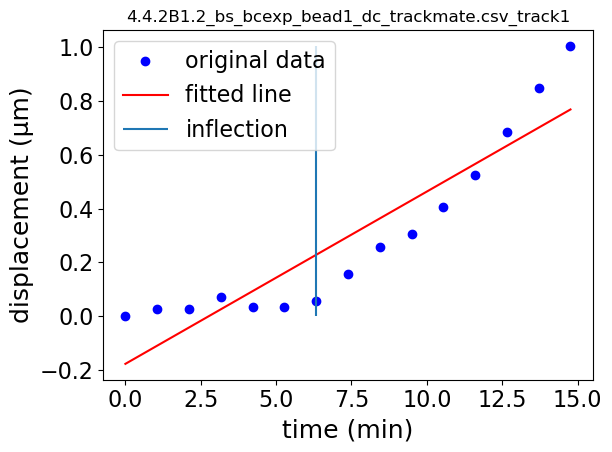

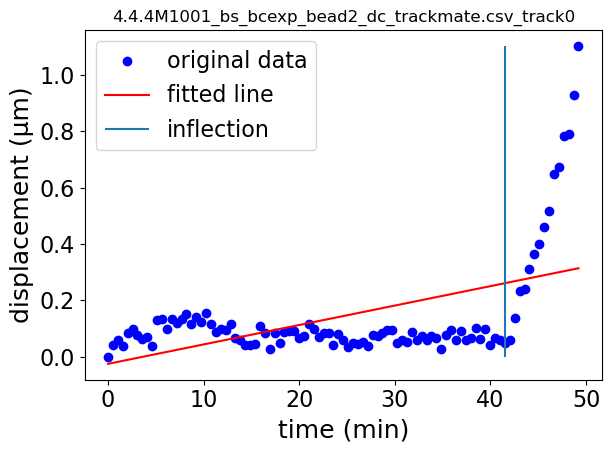

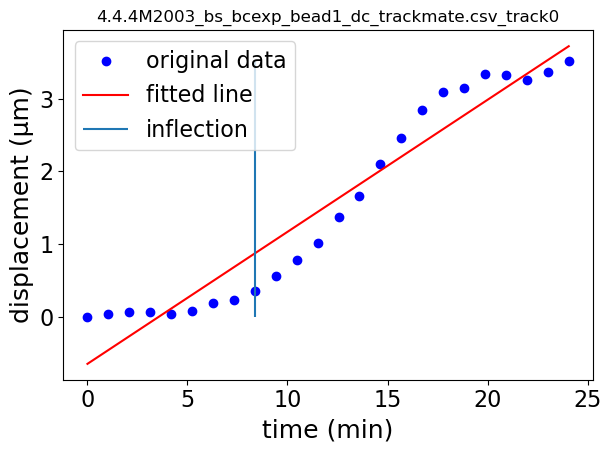

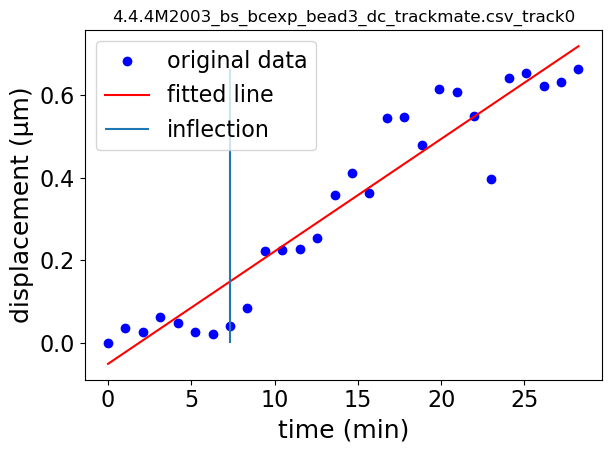

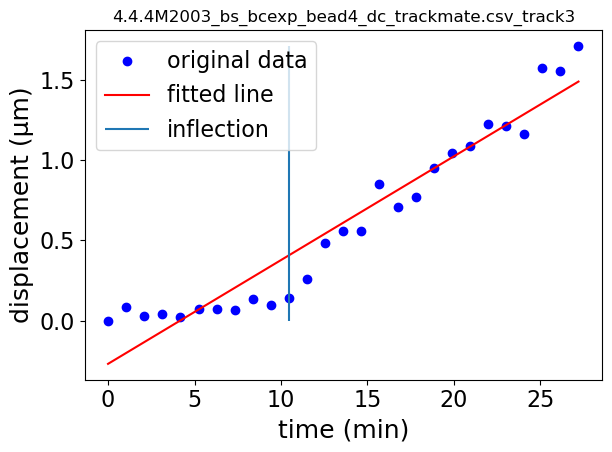

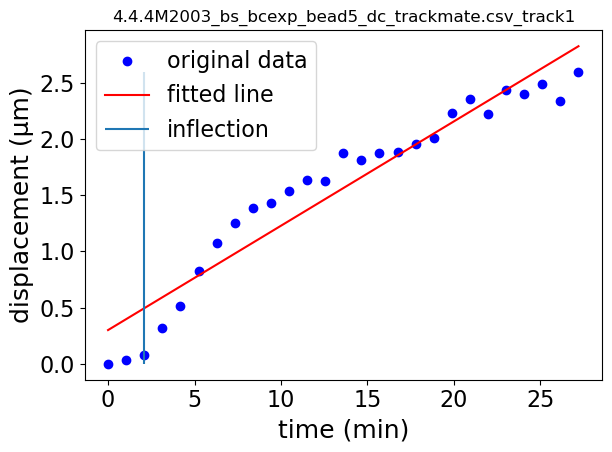

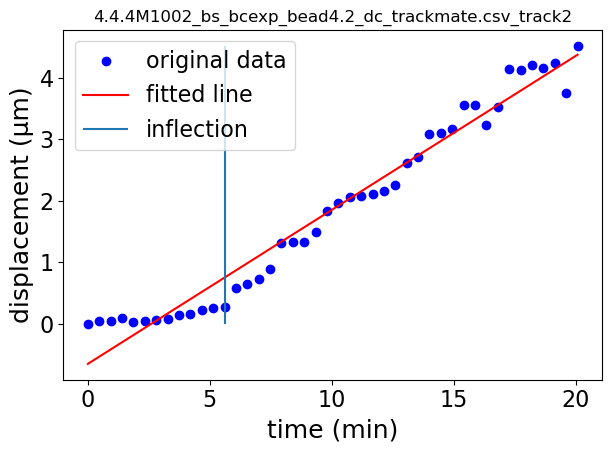

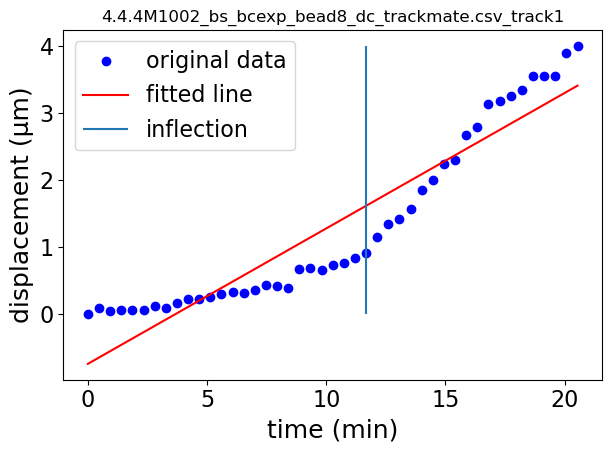

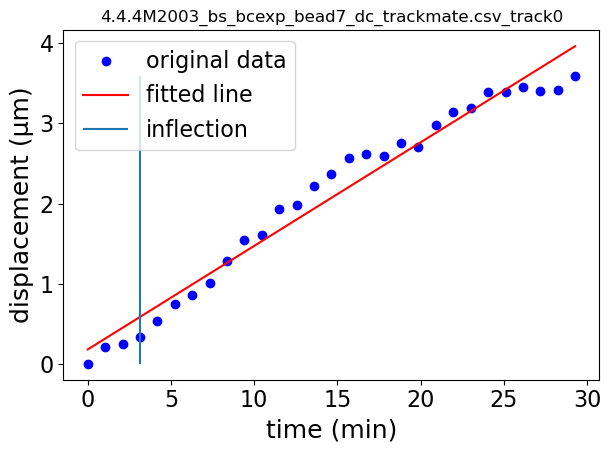

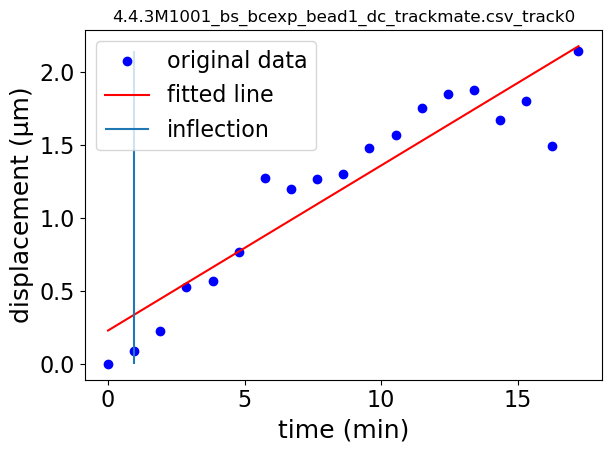

In [49]:
for track in list(tracks_dict)[::4]:
    df = tracks_dict[track].set_index('FRAME')
    time = df['POSITION_T']/60   
    ax = findInflectionPoint(time, df['DISPLACEMENT'],debug=True)
    plt.title(track, size=12)
    plt.tight_layout()
    plt.savefig('figures/findInflectionPoint_'+track+'.png')
    plt.savefig('figures/findInflectionPoint_'+track+'.svg')

## Plot fluorescence, displacement, and inflection point for all tracks

In [ ]:
num_plots = len(tracks_dict)
width = 3
height = num_plots//width + 1

fig, ax = plt.subplots(nrows=height, ncols=width, sharex=True, sharey=True, figsize=(5*width,3*height))
fig.add_subplot(111, frameon=False)
plt.tick_params(labelcolor='none', top='off', bottom='off', left='off', right='off')
plt.grid(False)
fig.text(0.5, 0, 'Time (minutes)', ha='center', size=20)
fig.text(0.05, 0.5, 'Normalized Fluorescence Intensity', va='center', rotation='vertical', size=20)
fig.text(0.95, 0.5, 'Vesicle Displacement (µm)', va='center', rotation='vertical', size=20, color='blue')

#plt.tight_layout()

plot_no = 0

for track in tracks_dict:
    plot_no += 1
    ax1 = plt.subplot(height,width,plot_no) #height, width
    ax2 = ax1.twinx()
    df = tracks_dict[track].set_index('FRAME')
    time = df['POSITION_T']/60
    ax1.plot(time, df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01']), 
             color='magenta', label = 'Sac6-RFP')
    ax1.plot(time, df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02']), 
             color='green', label = 'Bzz1-GFP')
    #plt.plot(time, df['MEAN_INTENSITY03']/np.max(df['MEAN_INTENSITY03']))
    #ax2.plot(time, df['DISPLACEMENT']/np.max(df['DISPLACEMENT']), color = 'cyan', label = 'Vesicle displacement')
    #percentile = np.percentile(df['DISPLACEMENT'], 20)
    #percentile = max(df['DISPLACEMENT'])*0.15
    inflection = findInflectionPoint(time, df['DISPLACEMENT'])
    ax2.plot(time, df['DISPLACEMENT'], color = 'blue', label = 'Displacement')
    ax1.vlines(time[inflection], 0, 1, color = 'orange', label = 'Inflection point')
    #plt.xlim(right = 50)
    #plt.ylim(top = 6)
    title = track.split('_')[0]+'_'+track.split('_')[3]+'_'+track.split('_')[-1]
    plt.title(title)
    if plot_no == 3:
        ax1.legend()

#fig.delaxes(ax.flatten()[num_plots:])

#while num_plots < width*height:
#    extra = width*height - num_plots
#    fig.delaxes(ax.flatten()[-1])
#    num_plots += 1

plt.tight_layout(pad = 1, rect = (0.05, 0.005, 0.95, 1))

#plt.savefig(working_dir+'figures/'+pref+'_individual_tracks.png')
plt.savefig('figures/individual_tracks.png')

## Figure 3B: plot fluorescence, displacement, and inflection point for track visualized in figure 3A

In [ ]:
track = '4.4.3M1001_bs_bcexp_bead1_dc_trackmate.csv_track0'

ax1 = plt.subplot(1,1,1)
ax2 = ax1.twinx()
df = tracks_dict[track].set_index('FRAME')
time = df['POSITION_T']/60
inflection = findInflectionPoint(time, df['DISPLACEMENT'])
time_aligned = time - inflection
ax1.plot(time_aligned, df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01']), 
         color='magenta', label = 'Sac6-RFP')
ax1.plot(time_aligned, df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02']), 
         color='green', label = 'Bzz1-GFP')
ax2.plot(time_aligned, df['DISPLACEMENT'], linestyle=':',
         color = 'blue', label = 'Displacement')
plt.tick_params(labelcolor='blue')
plt.ylabel('Vesicle Displacement (µm)', color='blue')
ax1.vlines(time[inflection]-inflection, 0, 1, linestyle='dashed', color = 'orange', label = 'Inflection point')
ax1.set(xlabel = 'Time (minutes)', ylabel = 'Normalized Fluorescence Intensity')
#ax2.set(ylabel = 'Vesicle Displacement (µm)', color='blue')
ax1.legend(loc='lower right')

plt.savefig('figures/5b_track.svg')
plt.savefig('figures/5b_track.png')

## Align time to inflection point, take mean by aligned time

In [ ]:
for track in tracks_dict:
    df = tracks_dict[track].set_index("FRAME")
    time = df['POSITION_T']
    displacement = df['DISPLACEMENT']
    inflection = findInflectionPoint(time, displacement)
    time_aligned = (time - time[inflection])//60 #round down to 1 minute
    print(min(time_aligned), max(time_aligned))
    df['time_aligned'] = time_aligned
    displacement_aligned = displacement - displacement[inflection]
    df['displacement_aligned']= displacement_aligned
    rfp_norm = df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01'])
    df['rfp_norm'] = rfp_norm
    gfp_norm = df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02'])
    df['gfp_norm'] = gfp_norm
    tracks_dict[track] = df

In [ ]:
all_tracks = pd.concat(tracks_dict, sort=False)
all_tracks_combined = all_tracks.groupby('time_aligned').agg(['mean','std','count'])

## Plot all aligned traces on same graph

In [ ]:
fig, ax = plt.subplots(nrows=height, ncols=width, sharex=True, sharey=True, figsize=(10,6))
fig.add_subplot(111, frameon=False)
plt.tick_params(labelcolor='none', top='off', bottom='off', left='off', right='off')
plt.grid(False)
fig.text(0.5, 0, 'Time (minutes)', ha='center', size=20)
fig.text(0.03, 0.5, 'Normalized Fluorescence Intensity', va='center', rotation='vertical', size=20)
fig.text(0.95, 0.5, 'Vesicle Displacement (µm)', va='center', rotation='vertical', size=20, color='blue')

ax1 = plt.subplot(111) #height, width
ax2 = ax1.twinx()

plot_no = 0

for track in tracks_dict:
    plot_no += 1
    df = tracks_dict[track]
    time = df['time_aligned']
    ax1.plot(time, df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01']), 
             color='magenta', label = 'Sac6-RFP')
    ax1.plot(time, df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02']), 
             color='green', label = 'Bzz1-GFP')
    ax2.plot(time, df['DISPLACEMENT'], color = 'blue', label = 'Displacement')
#    ax1.vlines(time[inflection], 0, 1, color = 'orange', label = 'Inflection point')
    if plot_no == 1:
            ax1.legend()

plt.tight_layout(pad = 1, rect = (0.05, 0.005, 0.95, 1))

plt.xlim(left= -30, right = 20)

#plt.savefig(working_dir+'figures/'+pref+'_norm_tracks_overlay.png')

## Figure 3C: Plot mean aligned fluorescence and displacement

In [ ]:
time_aligned = all_tracks_combined.index
displacement = all_tracks_combined['DISPLACEMENT']
displacement_aligned = all_tracks_combined['displacement_aligned']
rfp = all_tracks_combined['rfp_norm']
gfp = all_tracks_combined['gfp_norm']

fig, ax = plt.subplots(1, 1, sharex=True, sharey=True, figsize=(10,6))
fig.add_subplot(111, frameon=False)
plt.tick_params(labelcolor='none', top='off', bottom='off', left='off', right='off')
plt.grid(False)
fig.text(0.5, 0, 'Time (minutes)', ha='center', size=20)
fig.text(0.03, 0.5, 'Mean Normalized Fluorescence Intensity', va='center', rotation='vertical', size=20)
fig.text(0.95, 0.5, 'Vesicle Displacement (µm)', va='center', rotation='vertical', size=20, color='blue')

ax1 = plt.subplot(111)
ax2 = ax1.twinx()
ax1.plot(time_aligned,rfp['mean'], 
         color='magenta', label = 'Sac6-RFP')
ax1.fill_between(time_aligned,rfp['mean'] - rfp['std'], 
                 rfp['mean'] + rfp['std'], color='magenta', alpha=0.2)

ax1.plot(time_aligned,gfp['mean'], 
         color='green', label = 'Bzz1-GFP')
ax1.fill_between(time_aligned,gfp['mean'] - gfp['std'], 
                 gfp['mean'] + gfp['std'], color='green', alpha=0.2)

ax2.plot(time_aligned,displacement['mean'], color = 'blue', label='displacement')
ax2.fill_between(time_aligned,displacement['mean'] - displacement['std'], 
                 displacement['mean'] + displacement['std'], color='blue', alpha=0.2)
plt.tick_params(labelcolor='blue')

fig.legend(loc='lower right', bbox_to_anchor=(1,0), bbox_transform=ax1.transAxes)

#plt.plot(time_aligned,displacement_aligned, color = 'blue', label='aligned displacement')
#plt.fill_between(time_aligned,displacement_aligned - error['displacement_aligned'], 
#                 displacement_aligned + error['displacement_aligned'], color='blue', alpha=0.2)
plt.xlim(left= -30, right = 20)

plt.tight_layout(pad = 1, rect = (0.05, 0.005, 0.95, 1))

plt.savefig('figures/5c_mean_tracks.svg')
plt.savefig('figures/5c_mean_tracks.png')

# All panels for figure 3

In [ ]:
all_frames = raw.metadata['frames']
micron_per_px = raw.metadata['pixel_microns']
s_per_frame = vis_params.loc['Confocal 561 2']['s_per_frame']
frames = all_frames[0:12]
count = 0
width = 1.5*len(frames)
height = 0.8*width
channels = ['Merge','Confocal 638','Confocal 561 2','Confocal 488']

track = '4.4.3M1001_bs_bcexp_bead1_dc_trackmate.csv_track0'

fig5 = plt.figure(figsize=(width, height), constrained_layout=False)
fig5.text(0.05,0.92,'A', fontsize=BIGGER_SIZE)
fig5.text(0.05,0.48,'B', fontsize=BIGGER_SIZE)
fig5.text(0.52,0.48,'C', fontsize=BIGGER_SIZE)

# gridspec inside gridspec
outer_grid = fig5.add_gridspec(2, 2, wspace=0.3, hspace=0.2)

# panel A
inner_grid = outer_grid[0:2].subgridspec(len(channels),len(frames),
                                         wspace=0.0, hspace=0.0)
fig5.text(0.5,0.92,'Incubation time (minutes:seconds)',fontsize=MEDIUM_SIZE,ha='center')
for channel in channels:
    for tp in frames:
        ax = fig5.add_subplot(inner_grid[count])
        count += 1
        ax.imshow(max_projections[channel][tp,50:400,580:910])
        if channel == channels[0]:
            minutes = int(s_per_frame*tp//60)
            seconds = int(np.round((s_per_frame*tp/60-minutes)*60))
            plt.title(str(80+minutes)+':'+str(seconds))
        if tp == frames[0]:
            plt.ylabel(vis_params.loc[channel]['label'],
                       rotation=0,color=vis_params.loc[channel]['color'],
                       ha='right',)
        if count == len(frames)*len(channels):
            scalebar = ScaleBar(micron_per_px/10, 'um', box_alpha=0, color='w', 
                                length_fraction=0.4, height_fraction=0.02)
            plt.gca().add_artist(scalebar)
        ax.set_xticks([])
        ax.set_yticks([])
        fig5.add_subplot(ax)
        
# panel B
ax1 = fig5.add_subplot(outer_grid[2])
ax2 = ax1.twinx()
df = tracks_dict[track]
time = df['POSITION_T']/60
inflection = findInflectionPoint(time, df['DISPLACEMENT'])
time_aligned = time - inflection

incubation_time = time+80

ax1.plot(incubation_time, df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01']), 
         color='magenta', label = 'Sac6-RFP')
ax1.plot(incubation_time, df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02']), 
         color='green', label = 'Bzz1-GFP')
ax2.plot(incubation_time, df['DISPLACEMENT'],
         color = 'blue', label = 'Displacement')
plt.tick_params(labelcolor='blue')
plt.ylabel('Vesicle Displacement (µm)', color='blue')
ax1.vlines(incubation_time[inflection], 0, 1, linestyle='dashed', color = 'orange', label = 'Inflection point')
ax1.set(xlabel = 'Incubation time (minutes)', ylabel = 'Normalized Fluorescence Intensity')
#ax1.legend(loc='lower right')
fig5.legend(loc='lower right', bbox_to_anchor=(1,0), bbox_transform=ax1.transAxes)

# panel C
ax1 = fig5.add_subplot(outer_grid[3])
ax2 = ax1.twinx()

time_aligned = all_tracks_combined.index
displacement = all_tracks_combined['DISPLACEMENT']
displacement_aligned = all_tracks_combined['displacement_aligned']
rfp = all_tracks_combined['rfp_norm']
gfp = all_tracks_combined['gfp_norm']


ax1.plot(time_aligned,rfp['mean'], 
         color='magenta', label = 'Sac6-RFP')
ax1.fill_between(time_aligned,rfp['mean'] - rfp['std'], 
                 rfp['mean'] + rfp['std'], color='magenta', alpha=0.2)

ax1.plot(time_aligned,gfp['mean'], 
         color='green', label = 'Bzz1-GFP')
ax1.fill_between(time_aligned,gfp['mean'] - gfp['std'], 
                 gfp['mean'] + gfp['std'], color='green', alpha=0.2)

ax2.plot(time_aligned,displacement['mean'], color = 'blue', label='Displacement')
ax1.plot(np.nan, color = 'blue', label='Displacement')
ax2.fill_between(time_aligned,displacement['mean'] - displacement['std'], 
                 displacement['mean'] + displacement['std'], color='blue', alpha=0.2)
plt.tick_params(labelcolor='blue')
plt.ylabel('Vesicle Displacement (µm)', color='blue')
ax1.set(xlabel = 'Time relative to inflection point (minutes)', ylabel = 'Normalized Fluorescence Intensity')
ax1.legend(loc='center left')
#fig5.legend(loc='lower right', bbox_to_anchor=(1,0), bbox_transform=ax1.transAxes)

plt.xlim(left= -35, right = 20)

plt.savefig('figures/fig5_abc.png')
plt.savefig('figures/fig5_abc.svg')

# Supplemental figure S4

## Supplemental figure S4 top row

### Set paths to data

In [108]:
crop_tiff = 'data/4.4.4M1001_bs_bcexp_bead2_dc_bchist.tif'
raw_nd2 = 'data/4.4.4M1001.nd2'
track_csv = 'tracks/4.4.4M1001_bs_bcexp_bead2_dc_trackmate.csv'

### Read processed single bead crop

In [109]:
crop = io.imread(crop_tiff)
crop.shape

Exception in callback BaseAsyncIOLoop._handle_events(8600, 1)
handle: <Handle BaseAsyncIOLoop._handle_events(8600, 1)>
Traceback (most recent call last):
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\tornado\platform\asyncio.py", line 206, in _handle_events
    handler_func(fileobj, events)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 578, in _handle_events
    self._handle_recv()
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 607, in _handle_recv
    self._run_callback(callback, msg)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 557, in _run_callback
    callback(*args, **kwargs)
  File "C:\Users\Nic

(97, 23, 77, 79, 3)

### Read raw data corresponding to processed stack

In [110]:
raw = ND2Reader(raw_nd2)
raw.bundle_axes = 'czyx'
raw

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\nd2reader\common.py:279: RuntimeWarning: coroutine 'get_msg' was never awaited
  metadata = {}


<FramesSequenceND>
Axes: 5
Axis 'x' size: 512
Axis 'y' size: 512
Axis 'c' size: 3
Axis 't' size: 97
Axis 'z' size: 21
Pixel Datatype: <class 'numpy.float64'>

### Read metadata from raw data

In [111]:
raw_metadata = nd2_metadata(raw)

In [112]:
channel_names = {'sac6':'Confocal 561 2',
                'bzz1':'Confocal 488',
                'dope':'Confocal 638'}
contrast = {'sac6':(345,1307),
            'bzz1':(180,490),
            'dope':(1160,2230)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
#labels = {'sac6':'Sac6-RFP',
#        'bzz1':'Bzz1-GFP',
#        'dope':'ATTO647-DOPE',
#         'merge':'Merge'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE'}

vis_params = pd.DataFrame({'channel':channel_names,
             'contrast':contrast,
             'color':colors,
             'label':labels}).set_index('channel')
channel_order = {'stack_index':{}}
for i, channel in enumerate(raw_metadata['channel']):
    channel_order['stack_index'][channel] = i

vis_params = pd.concat([vis_params,pd.DataFrame(channel_order),
                       pd.DataFrame(raw_metadata).set_index('channel')],axis=1)

# hack to add merge visualization
vpm = vis_params.loc[vis_params.index[0]].copy()
vpm['label'] = 'Merge'
vpm['color'] = 'black'
vis_params.loc['Merge'] = vpm

#vis_params.loc['Merge'] = vis_params.loc[vis_params.index[0]].copy()
#vis_params.loc['Merge']['color'] = 'black'
#vis_params.loc['Merge']['label'] = 'Merge'
vis_params

,contrast,color,label,stack_index,num_frames,s_per_frame,s_total,micron_per_px,min_z,max_z,z_range,z_slices,z_spacing,trackmate_z_ratio,trackmate_xy_ratio
Confocal 561 2,"(345, 1307)",magenta,Sac6-RFP,0,97,0.0,2967.991596,0.140467,2044.65,2054.7,10.05,21,0.478571,0.957143,0.999763
Confocal 488,"(180, 490)",green,Bzz1-GFP,1,97,0.0,2967.991596,0.140467,2044.65,2054.7,10.05,21,0.478571,0.957143,0.999763
Confocal 638,"(1160, 2230)",cyan,ATTO647-DOPE,2,97,0.0,2967.991596,0.140467,2044.65,2054.7,10.05,21,0.478571,0.957143,0.999763
Merge,"(345, 1307)",black,Merge,0,97,0.0,2967.991596,0.140467,2044.65,2054.7,10.05,21,0.478571,0.957143,0.999763


In [113]:
# I couldn't work this one into the dataframe
num_frames = vis_params['num_frames'][0]
s_per_frame = vis_params['s_per_frame'][0]
s_per_frame = vis_params['s_total'][0]/num_frames
s_timestamps = np.arange(num_frames)*s_per_frame+(80*60)

### Read vesicle tracking data

In [114]:
trackmate_xy_ratio = vis_params['trackmate_xy_ratio'][0]
trackmate_z_ratio = vis_params['trackmate_z_ratio'][0]
micron_per_px = vis_params['micron_per_px'][0]
px_per_micron = 1/micron_per_px

track_df = pd.read_csv(track_csv)
frames = track_df['FRAME']
x = track_df['POSITION_X']*trackmate_xy_ratio*px_per_micron
y = track_df['POSITION_Y']*trackmate_xy_ratio*px_per_micron
z = track_df['POSITION_Z']*trackmate_z_ratio*px_per_micron
spots = np.transpose(np.array([frames,z,y,x]))
traj = np.transpose(np.array([z,y,x]))

### Make movies/montages

#### full time lapse

##### write movie script

In [26]:
tl_frames = crop.shape[0]-1
with open("movies/s5a_movie_script.txt", "w") as text_file:
    print('From frame 0 to frame 0\n'
    '-rotate by 30 degrees around (1,0,0)\n'
    f'From frame 0 to frame {tl_frames}\n'
    f'-shift time by {tl_frames}', file=text_file)

#### Narrower z-section time lapse

##### Record movies in napari

###### merge of sac6, bzz1, and lipid

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\vispy\visuals\tube.py:136: RuntimeWarning: invalid value encountered in divide
  tangents /= mags[:, np.newaxis]
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  command_list = np.array(command_list)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:193: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  current_sta

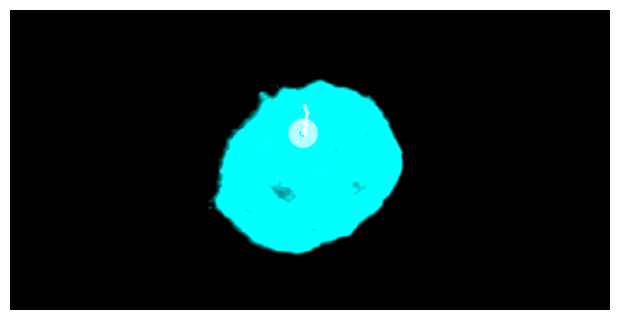

MovieWriter ffmpeg unavailable; using Pillow instead.
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3

ValueError: unknown file extension: .mp4

In [29]:
movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         points=spots, traj=traj, z_low=4, z_high=19,
        script='movies/s5a_movie_script.txt', movie_name='s5a_spots_traj_movie')

movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         points=spots, z_low=4, z_high=19,
        script='movies/s5a_movie_script.txt', movie_name='s5a_spots_movie')

movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         z_low=4, z_high=19,
        script='movies/s5a_movie_script.txt', movie_name='s5a_movie')

###### sac6, bzz1, and lipid with 3D rotation and annotations

In [45]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s5a_rotation_annotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
'-rotate by 30 degrees around (1,0,0)\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames} to frame {rotation_frames+tl_delay} shift time by {tl_frames}\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames*2+tl_delay} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay} to frame {rotation_frames*2+tl_delay*2} shift time by {-tl_frames}', 
        file=text_file)

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 97 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 97 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\vispy\visuals\tube.py:134: RuntimeWarning: invalid value encountered in true_divide
  tangents /= mags[:, np.newaxis]
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color par

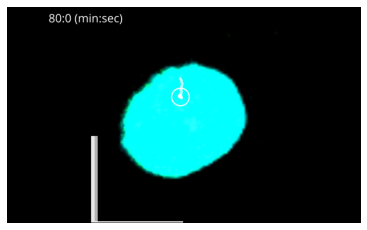

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 97 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 97 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\vispy\visuals\tube.py:134: RuntimeWarning: invalid value encountered in true_divide
  tangents /= mags[:, np.newaxis]
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color par

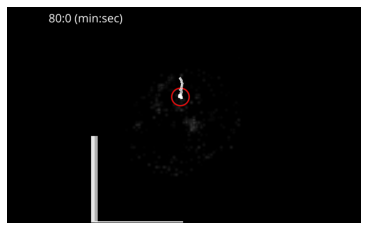

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 97 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 97 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\vispy\visuals\tube.py:134: RuntimeWarning: invalid value encountered in true_divide
  tangents /= mags[:, np.newaxis]
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color par

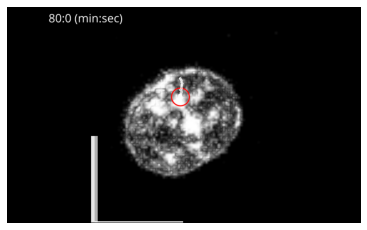

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 97 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 97 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\vispy\visuals\tube.py:134: RuntimeWarning: invalid value encountered in true_divide
  tangents /= mags[:, np.newaxis]
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color par

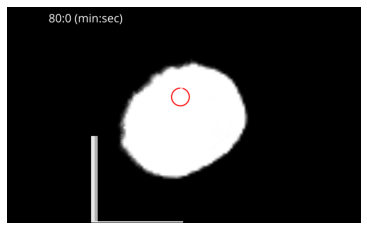

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

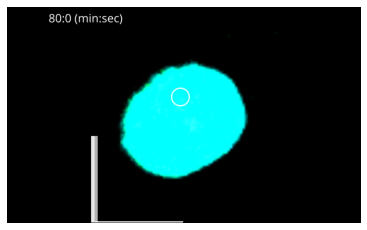

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

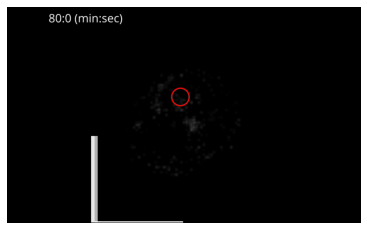

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

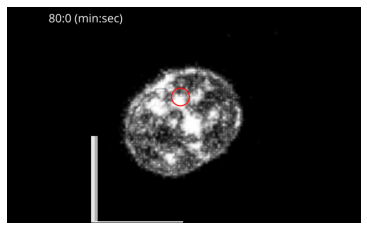

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

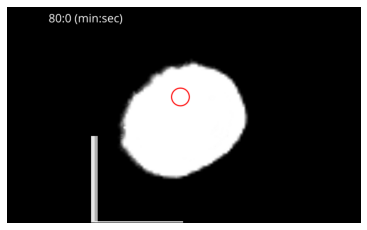

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

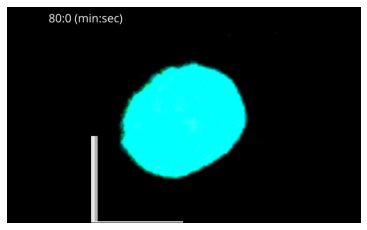

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

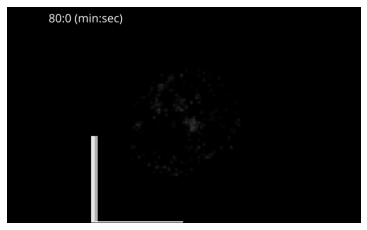

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

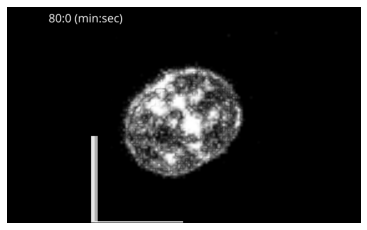

C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided edge_color parameter has 2 entries, while the data contains 1 entries. Setting edge_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\utils\color_transformations.py:51: UserWarning: The provided face_color parameter has 2 entries, while the data contains 1 entries. Setting face_color to white.
  warnings.warn(
C:\Users\Nice\miniconda3\lib\site-packages\napari\layers\uti

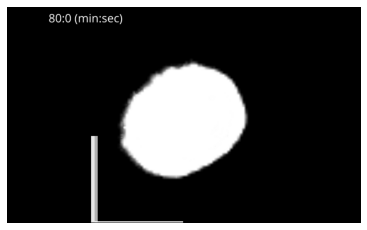

In [23]:
# origin at bottom left
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj, z_low=4, z_high=19,
                   script='movies/s5a_rotation_annotated_movie_script.txt', 
                   movie_name='s5a_rotation_spots_traj_movie_annotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps)

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, z_low=4, z_high=19,
                   script='movies/s5a_rotation_annotated_movie_script.txt', 
                   movie_name='s5a_rotation_spots_movie_annotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps)

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, z_low=4, z_high=19,
                   script='movies/s5a_rotation_annotated_movie_script.txt', 
                   movie_name='s5a_rotation_movie_annotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps)

###### 3d rotation with trajectory appearing halfway through

In [58]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s5a_rotation_advannotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
'-rotate by 30 degrees around (1,0,0)\n'
'At frame 0 make layer 4 invisible\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames} to frame {rotation_frames+tl_delay} shift time by {tl_frames}\n'
f'At frame {rotation_frames+tl_delay} make layer 4 visible\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames+tl_delay*2} shift time by -{tl_frames}\n'
f'From frame {rotation_frames+tl_delay*2} to frame {rotation_frames*2+tl_delay*2} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay*2} to frame {rotation_frames*2+tl_delay*3} shift time by {tl_frames}', 
        file=text_file)

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\vispy\visuals\tube.py:136: RuntimeWarning: invalid value encountered in divide
  tangents /= mags[:, np.newaxis]
Exception in callback BaseAsyncIOLoop._handle_events(6736, 1)
handle: <Handle BaseAsyncIOLoop._handle_events(6736, 1)>
Traceback (most recent call last):
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\tornado\platform\asyncio.py", line 206, in _handle_events
    handler_func(fileobj, events)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 578, in _handle_events
    self._handle_recv()
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 607, in _handle_recv
    self._run_callback(callback, msg)
 

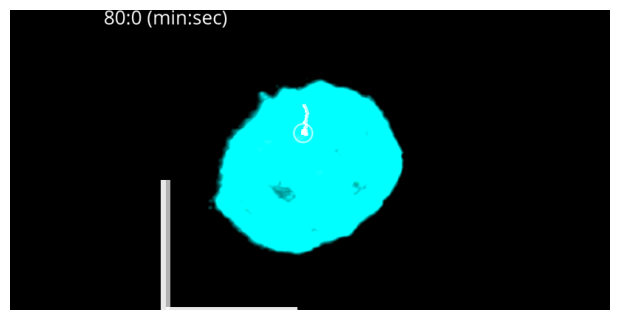

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

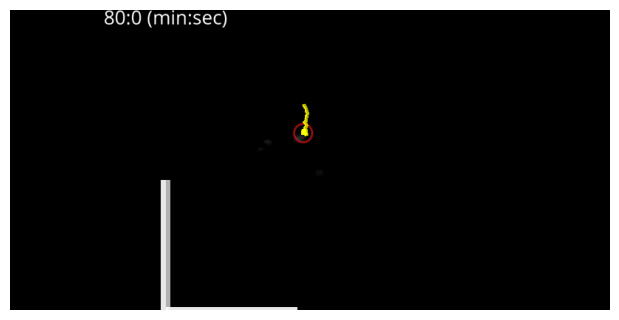

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

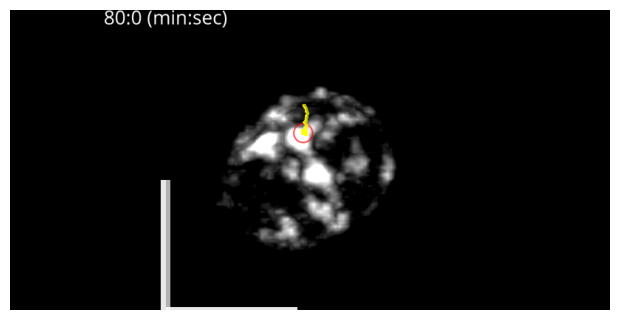

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

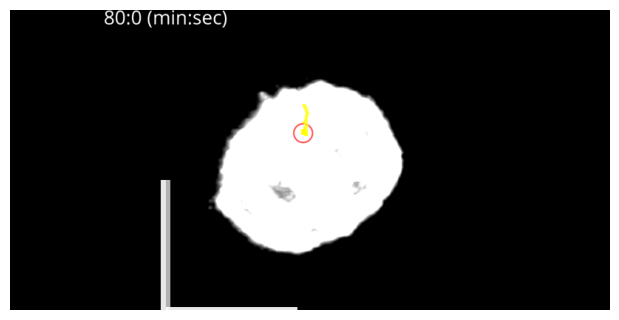

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

In [59]:
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj, z_low=4, z_high=19,
                   script='movies/s5a_rotation_advannotated_movie_script.txt', 
                   movie_name='s5a_rotation_spots_traj_movie_advannotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps)

###### 3d rotation halfway through with trajectory appearing

In [64]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s6_rotation_advannotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
'-rotate by 30 degrees around (1,0,0)\n'
'At frame 0 make layer 4 invisible\n'
f'From frame 0 to frame {tl_delay} shift time by {tl_frames}\n'
f'At frame {tl_delay} make layer 4 visible\n'
f'From frame {tl_delay} to frame {rotation_frames+tl_delay} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames+tl_delay*2} shift time by -{tl_frames}\n'
f'From frame {rotation_frames+tl_delay*2} to frame {rotation_frames*2+tl_delay*2} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay*2} to frame {rotation_frames*2+tl_delay*3} shift time by {tl_frames}', 
        file=text_file)

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\vispy\visuals\tube.py:136: RuntimeWarning: invalid value encountered in divide
  tangents /= mags[:, np.newaxis]
Exception in callback BaseAsyncIOLoop._handle_events(7816, 1)
handle: <Handle BaseAsyncIOLoop._handle_events(7816, 1)>
Traceback (most recent call last):
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\tornado\platform\asyncio.py", line 206, in _handle_events
    handler_func(fileobj, events)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 578, in _handle_events
    self._handle_recv()
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 607, in _handle_recv
    self._run_callback(callback, msg)
 

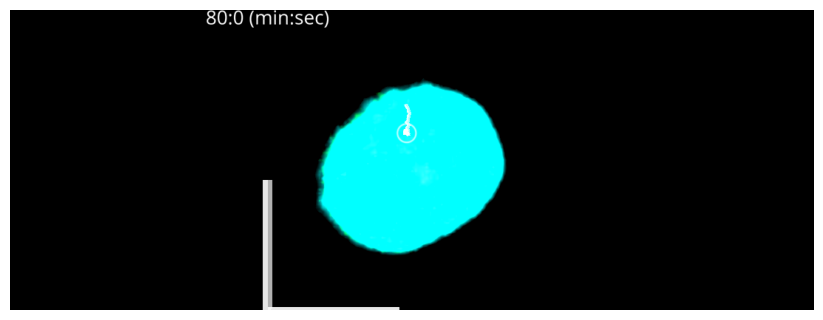

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

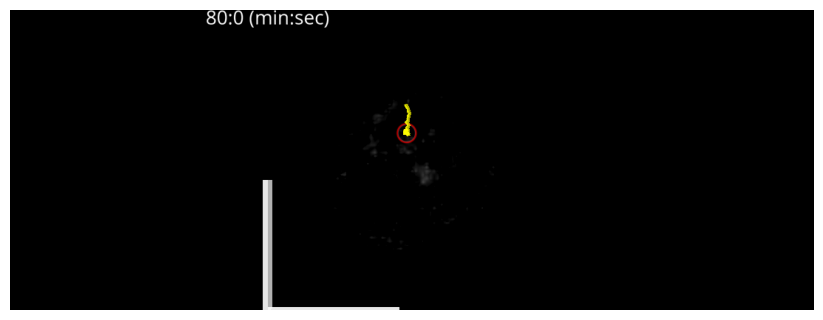

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

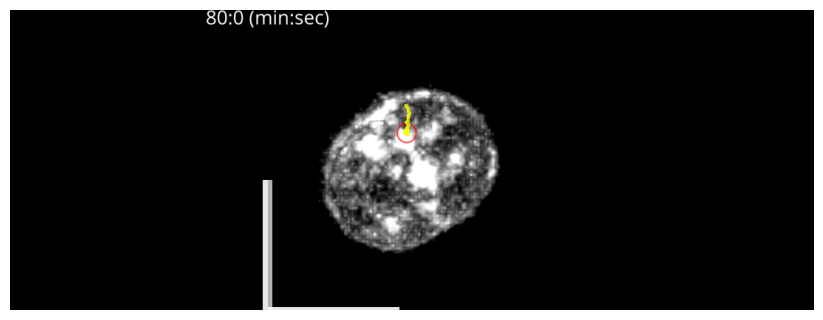

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

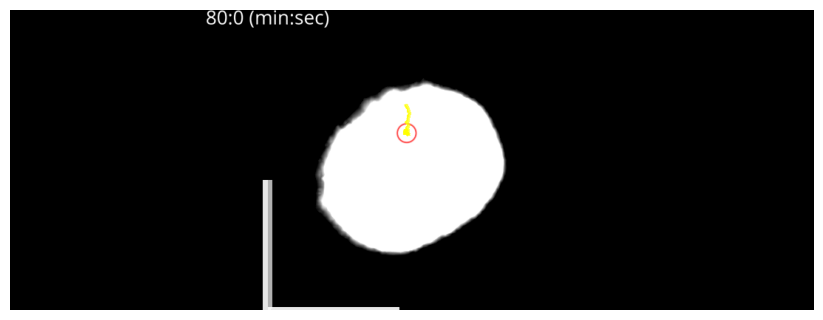

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

In [65]:
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj, z_low=4, z_high=19,
                   script='movies/s6_rotation_advannotated_movie_script.txt', 
                   movie_name='s6_rotation_spots_traj_movie_advannotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps, 
                  close_window=False)

##### Read movies

In [ ]:
max_projections = {'Merge':skvideo.io.vread('movies/s5a_spots_movie_merge.mp4'),
                  'Confocal 561 2':skvideo.io.vread('movies/s5a_movie_Sac6-RFP.mp4'),
                  'Confocal 488':skvideo.io.vread('movies/s5a_movie_Bzz1-GFP.mp4'),
                  'Confocal 638':skvideo.io.vread('movies/s5a_movie_ATTO647-DOPE.mp4')}
max_projections['Merge'].shape

In [ ]:
all_frames = raw.metadata['frames']
s_per_frame = vis_params.loc['Confocal 561 2']['s_per_frame']
frames = all_frames[-21::2]
count = 0
width = 1.5*len(frames)
height = 0.8*width
channels = ['Merge','Confocal 638','Confocal 561 2','Confocal 488']

track = '4.4.4M1001_bs_bcexp_bead2_dc_trackmate.csv_track0'

fig5 = plt.figure(figsize=(width, height), constrained_layout=False)
fig5.text(0.05,0.92,'A', fontsize=BIGGER_SIZE)
fig5.text(0.05,0.48,'B', fontsize=BIGGER_SIZE)
#fig5.text(0.52,0.48,'C', fontsize=BIGGER_SIZE)

# gridspec inside gridspec
outer_grid = fig5.add_gridspec(2, 2, wspace=0.3, hspace=0.2)

# panel A
inner_grid = outer_grid[0:2].subgridspec(len(channels),len(frames),
                                         wspace=0.0, hspace=0.0)
fig5.text(0.5,0.92,'Incubation time (minutes:seconds)',fontsize=MEDIUM_SIZE,ha='center')
for channel in channels:
    for tp in frames:
        ax = fig5.add_subplot(inner_grid[count])
        count += 1
        ax.imshow(max_projections[channel][tp,100:380,600:890])
        if channel == channels[0]:
            minutes = int(s_per_frame*tp//60)
            seconds = int(np.round((s_per_frame*tp/60-minutes)*60))
            plt.title(str(80+minutes)+':'+str(seconds))
        if tp == frames[0]:
            plt.ylabel(vis_params.loc[channel]['label'],
                       rotation=0,color=vis_params.loc[channel]['color'],
                       ha='right',)
        if count == len(frames)*len(channels):
            scalebar = ScaleBar(micron_per_px/10, 'um', box_alpha=0, color='w', 
                                length_fraction=0.4, height_fraction=0.02)
            plt.gca().add_artist(scalebar)
        ax.set_xticks([])
        ax.set_yticks([])
        fig5.add_subplot(ax)
        
# panel B
ax1 = fig5.add_subplot(outer_grid[2:4])
ax2 = ax1.twinx()
df = tracks_dict[track]
time = df['POSITION_T']/60
inflection = findInflectionPoint(time, df['DISPLACEMENT'])
time_aligned = time - inflection

incubation_time = time+80

ax1.plot(incubation_time, df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01']), 
         color='magenta', label = 'Sac6-RFP')
ax1.plot(incubation_time, df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02']), 
         color='green', label = 'Bzz1-GFP')
ax2.plot(incubation_time, df['DISPLACEMENT'],
         color = 'blue', label = 'Displacement')
plt.tick_params(labelcolor='blue')
plt.ylabel('Vesicle Displacement (µm)', color='blue')
ax1.vlines(incubation_time[inflection], 0, 1, linestyle='dashed', color = 'orange', label = 'Inflection point')
ax1.set(xlabel = 'Incubation time (minutes)', ylabel = 'Normalized Fluorescence Intensity')
#plt.xlim(left=90)
#ax1.legend(loc='lower right')
fig5.legend(loc='center left', bbox_to_anchor=(0,0.5), bbox_transform=ax1.transAxes)

plt.savefig('figures/figs5ab.png')
plt.savefig('figures/figs5ab.svg')

## Supplemental figure S4 middle row

### Set paths to data

In [115]:
crop_tiff = 'data/4.4.4M2003_bs_bcexp_bead7_dc.tif'
raw_nd2 = 'data/4.4.4M2003.nd2'
track_csv = 'tracks/4.4.4M2003_bs_bcexp_bead7_dc_trackmate.csv'
track = '4.4.4M2003_bs_bcexp_bead7_dc_trackmate.csv_track3'

### Read processed single bead crop

In [116]:
crop = io.imread(crop_tiff)
crop.shape

(29, 60, 75, 82, 3)

### Read raw data corresponding to processed stack

In [117]:
raw = ND2Reader(raw_nd2)
raw.bundle_axes = 'czyx'
raw

<FramesSequenceND>
Axes: 5
Axis 'x' size: 512
Axis 'y' size: 512
Axis 'c' size: 3
Axis 't' size: 29
Axis 'z' size: 46
Pixel Datatype: <class 'numpy.float64'>

### Read metadata from raw data

In [118]:
raw_metadata = nd2_metadata(raw, trackmate_z_spacing=0.2)

In [119]:
channel_names = {'sac6':'Confocal 561 2',
                'bzz1':'Confocal 488',
                'dope':'Confocal 638'}
contrast = {'sac6':(240,1250),
            'bzz1':(145,560),
            'dope':(350,730)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
#labels = {'sac6':'Sac6-RFP',
#        'bzz1':'Bzz1-GFP',
#        'dope':'ATTO647-DOPE',
#         'merge':'Merge'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE'}

vis_params = pd.DataFrame({'channel':channel_names,
             'contrast':contrast,
             'color':colors,
             'label':labels}).set_index('channel')
channel_order = {'stack_index':{}}
for i, channel in enumerate(raw_metadata['channel']):
    channel_order['stack_index'][channel] = i

vis_params = pd.concat([vis_params,pd.DataFrame(channel_order),
                       pd.DataFrame(raw_metadata).set_index('channel')],axis=1)

# hack to add merge visualization
vpm = vis_params.loc[vis_params.index[0]].copy()
vpm['label'] = 'Merge'
vpm['color'] = 'black'
vis_params.loc['Merge'] = vpm

#vis_params.loc['Merge'] = vis_params.loc[vis_params.index[0]].copy()
#vis_params.loc['Merge']['color'] = 'black'
#vis_params.loc['Merge']['label'] = 'Merge'
vis_params

,contrast,color,label,stack_index,num_frames,s_per_frame,s_total,micron_per_px,min_z,max_z,z_range,z_slices,z_spacing,trackmate_z_ratio,trackmate_xy_ratio
Confocal 561 2,"(240, 1250)",magenta,Sac6-RFP,0,29,0.0,1785.454631,0.140467,2062.425,2071.3,8.875,46,0.192935,0.964674,0.999763
Confocal 488,"(145, 560)",green,Bzz1-GFP,1,29,0.0,1785.454631,0.140467,2062.425,2071.3,8.875,46,0.192935,0.964674,0.999763
Confocal 638,"(350, 730)",cyan,ATTO647-DOPE,2,29,0.0,1785.454631,0.140467,2062.425,2071.3,8.875,46,0.192935,0.964674,0.999763
Merge,"(240, 1250)",black,Merge,0,29,0.0,1785.454631,0.140467,2062.425,2071.3,8.875,46,0.192935,0.964674,0.999763


In [120]:
# I couldn't work this one into the dataframe
num_frames = vis_params['num_frames'][0]
s_per_frame = vis_params['s_per_frame'][0]
s_per_frame = vis_params['s_total'][0]/num_frames
s_timestamps = np.arange(num_frames)*s_per_frame+(90*60)

### Read vesicle tracking data

In [121]:
trackmate_xy_ratio = vis_params['trackmate_xy_ratio'][0]
trackmate_z_ratio = vis_params['trackmate_z_ratio'][0]
micron_per_px = vis_params['micron_per_px'][0]
px_per_micron = 1/micron_per_px

track_df = tracks_dict[track].set_index('FRAME')
frames = track_df.index
x = track_df['POSITION_X']*trackmate_xy_ratio*px_per_micron
y = track_df['POSITION_Y']*trackmate_xy_ratio*px_per_micron
z = track_df['POSITION_Z']*trackmate_z_ratio*px_per_micron
spots = np.transpose(np.array([frames,z,y,x]))
traj = np.transpose(np.array([z,y,x]))

### Make movies/montages

#### full time lapse

##### write movie script

In [ ]:
tl_frames = crop.shape[0]-1
with open("movies/s5b_movie_script.txt", "w") as text_file:
    print('From frame 0 to frame 0\n'
    '-rotate by 90 degrees around (0,1,0)\n'
    f'From frame 0 to frame {tl_frames}\n'
    f'-shift time by {tl_frames}', file=text_file)

#### Narrower z-section time lapse

##### Record movies in napari

###### merge of sac6, bzz1, and lipid

In [ ]:
movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         points=spots, traj=traj, z_low=27, z_high=45,
        script='movies/s5b_movie_script.txt', movie_name='s5b_spots_traj_movie')

movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         points=spots, z_low=27, z_high=45,
        script='movies/s5b_movie_script.txt', movie_name='s5b_spots_movie')

movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         z_low=27, z_high=45,
        script='movies/s5b_movie_script.txt', movie_name='s5b_movie')

In [ ]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s5b_rotation_annotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
'-rotate by 30 degrees around (1,0,0)\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames} to frame {rotation_frames+tl_delay} shift time by {tl_frames}\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames*2+tl_delay} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay} to frame {rotation_frames*2+tl_delay*2} shift time by {-tl_frames}', 
        file=text_file)

In [ ]:
# origin at bottom left
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj,z_low=27, z_high=45,
                   script='movies/s5b_rotation_annotated_movie_script.txt', 
                   movie_name='s5b_rotation_spots_traj_movie_annotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps)


###### 3d rotation halfway through with trajectory appearing

In [73]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s7_rotation_advannotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
'-rotate by 30 degrees around (1,0,0)\n'
'At frame 0 make layer 4 invisible\n'
f'From frame 0 to frame {tl_delay} shift time by {tl_frames}\n'
f'At frame {tl_delay} make layer 4 visible\n'
f'From frame {tl_delay} to frame {rotation_frames+tl_delay} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames+tl_delay*2} shift time by -{tl_frames}\n'
f'From frame {rotation_frames+tl_delay*2} to frame {rotation_frames*2+tl_delay*2} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay*2} to frame {rotation_frames*2+tl_delay*3} shift time by {tl_frames}', 
        file=text_file)

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  command_list = np.array(command_list)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:193: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  current_state = copy.deepcopy(movie.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\numpy\core\fromnumeric.py:86: Visible

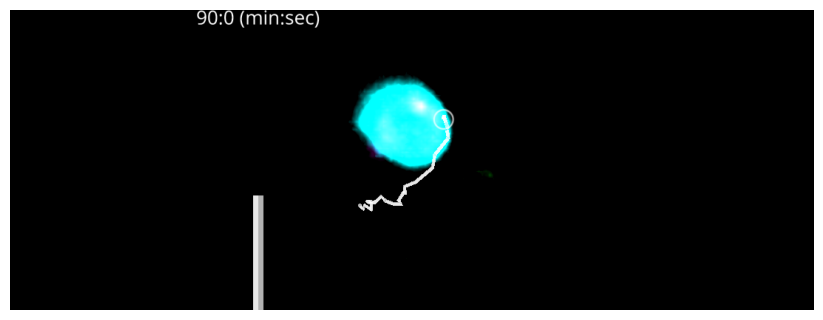

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

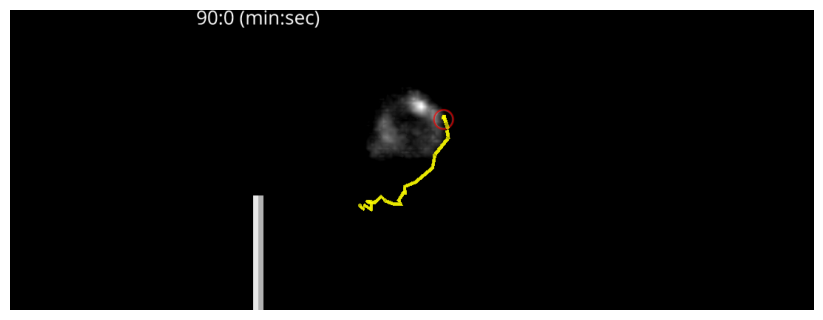

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

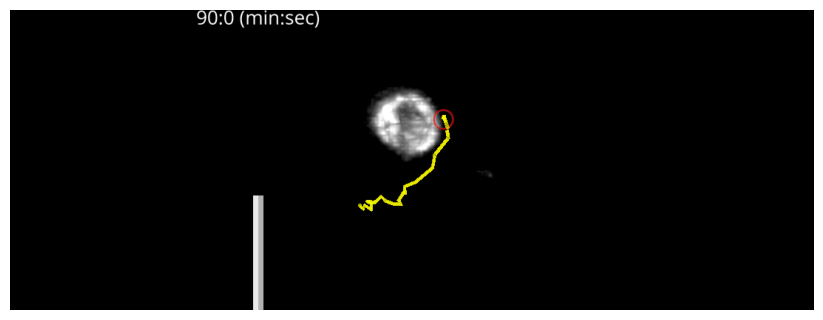

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

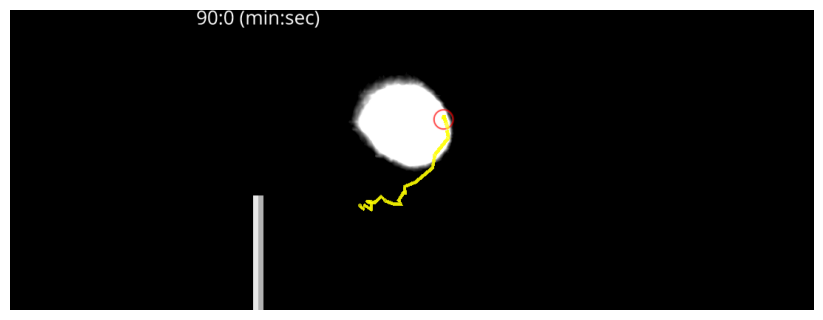

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

In [74]:
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj, z_low=27, z_high=45,
                   script='movies/s7_rotation_advannotated_movie_script.txt', 
                   movie_name='s7_rotation_spots_traj_movie_advannotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps, 
                  close_window=False)

##### Read movies

In [ ]:
max_projections = {'Merge':skvideo.io.vread('movies/s5b_spots_movie_merge.mp4'),
                  'Confocal 561 2':skvideo.io.vread('movies/s5b_movie_Sac6-RFP.mp4'),
                  'Confocal 488':skvideo.io.vread('movies/s5b_movie_Bzz1-GFP.mp4'),
                  'Confocal 638':skvideo.io.vread('movies/s5b_movie_ATTO647-DOPE.mp4')}
max_projections['Merge'].shape

In [ ]:
all_frames = raw.metadata['frames']
s_per_frame = vis_params.loc['Confocal 561 2']['s_per_frame']
frames = all_frames[4:-7:2]
count = 0
width = 1.8*len(frames)
height = 0.8*width
channels = ['Merge','Confocal 638','Confocal 561 2','Confocal 488']

fig5 = plt.figure(figsize=(width, height), constrained_layout=False)
fig5.text(0.05,0.92,'A', fontsize=BIGGER_SIZE)
fig5.text(0.05,0.48,'B', fontsize=BIGGER_SIZE)
#fig5.text(0.52,0.48,'C', fontsize=BIGGER_SIZE)

# gridspec inside gridspec
outer_grid = fig5.add_gridspec(2, 1, wspace=0.3, hspace=0.2)

# panel A
inner_grid = outer_grid[0].subgridspec(len(channels),len(frames),
                                         wspace=0.0, hspace=0.0)
fig5.text(0.5,0.92,'Incubation time (minutes:seconds)',fontsize=MEDIUM_SIZE,ha='center')
for channel in channels:
    for tp in frames:
        ax = fig5.add_subplot(inner_grid[count])
        count += 1
        ax.imshow(max_projections[channel][tp,250:-350,580:-580])
        if channel == channels[0]:
            minutes = int(s_per_frame*tp//60)
            seconds = int(np.round((s_per_frame*tp/60-minutes)*60))
            plt.title(str(90+minutes)+':'+str(seconds))
        if tp == frames[0]:
            plt.ylabel(vis_params.loc[channel]['label'],
                       rotation=0,color=vis_params.loc[channel]['color'],
                       ha='right',)
        if count == len(frames)*len(channels):
            scalebar = ScaleBar(micron_per_px/10, 'um', box_alpha=0, color='w', 
                                length_fraction=0.4, height_fraction=0.02)
            plt.gca().add_artist(scalebar)
        ax.set_xticks([])
        ax.set_yticks([])
        fig5.add_subplot(ax)
        
# panel B
ax1 = fig5.add_subplot(outer_grid[1])
ax2 = ax1.twinx()
df = tracks_dict[track].set_index('FRAME')
time = df['POSITION_T']/60
inflection = findInflectionPoint(time, df['DISPLACEMENT'])
time_aligned = time - inflection

incubation_time = time+90

ax1.plot(incubation_time, df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01']), 
         color='magenta', label = 'Sac6-RFP')
ax1.plot(incubation_time, df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02']), 
         color='green', label = 'Bzz1-GFP')
ax2.plot(incubation_time, df['DISPLACEMENT'],
         color = 'blue', label = 'Displacement')
plt.tick_params(labelcolor='blue')
plt.ylabel('Vesicle Displacement (µm)', color='blue')
ax1.vlines(incubation_time[inflection], 0, 1, linestyle='dashed', color = 'orange', label = 'Inflection point')
ax1.set(xlabel = 'Incubation time (minutes)', ylabel = 'Normalized Fluorescence Intensity')
#plt.xlim(left=90)
#ax1.legend(loc='lower right')
fig5.legend(loc='lower right', bbox_to_anchor=(1,0), bbox_transform=ax1.transAxes)

plt.savefig('figures/figs5b.png')
plt.savefig('figures/figs5b.svg')

## Supplemental figure S4 bottom row

### Set paths to data

In [75]:
crop_tiff = 'data/4.4.5M1002_bs_bcexp_bead1_dc.tif'
raw_nd2 = 'data/4.4.5M1002.nd2'
track = '4.4.5M1002_bs_bcexp_bead1_dc_trackmate.csv_track0'

### Read processed single bead crop

In [76]:
crop = io.imread(crop_tiff)
crop.shape

Exception in callback BaseAsyncIOLoop._handle_events(9200, 1)
handle: <Handle BaseAsyncIOLoop._handle_events(9200, 1)>
Traceback (most recent call last):
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\tornado\platform\asyncio.py", line 206, in _handle_events
    handler_func(fileobj, events)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 578, in _handle_events
    self._handle_recv()
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 607, in _handle_recv
    self._run_callback(callback, msg)
  File "C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\zmq\eventloop\zmqstream.py", line 557, in _run_callback
    callback(*args, **kwargs)
  File "C:\Users\Nic

(52, 72, 99, 83, 3)

### Read raw data corresponding to processed stack

In [77]:
raw = ND2Reader(raw_nd2)
raw.bundle_axes = 'czyx'
raw

<FramesSequenceND>
Axes: 5
Axis 'x' size: 512
Axis 'y' size: 512
Axis 'c' size: 3
Axis 't' size: 52
Axis 'z' size: 58
Pixel Datatype: <class 'numpy.float64'>

### Read metadata from raw data

In [78]:
raw_metadata = nd2_metadata(raw, trackmate_z_spacing=0.2)

In [79]:
channel_names = {'sac6':'Confocal 561 2',
                'bzz1':'Confocal 488',
                'dope':'Confocal 638'}
contrast = {'sac6':(630,2200),
            'bzz1':(450,1230),
            'dope':(680,1180)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
#labels = {'sac6':'Sac6-RFP',
#        'bzz1':'Bzz1-GFP',
#        'dope':'ATTO647-DOPE',
#         'merge':'Merge'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE'}

vis_params = pd.DataFrame({'channel':channel_names,
             'contrast':contrast,
             'color':colors,
             'label':labels}).set_index('channel')
channel_order = {'stack_index':{}}
for i, channel in enumerate(raw_metadata['channel']):
    channel_order['stack_index'][channel] = i

vis_params = pd.concat([vis_params,pd.DataFrame(channel_order),
                       pd.DataFrame(raw_metadata).set_index('channel')],axis=1)

# hack to add merge visualization
vpm = vis_params.loc[vis_params.index[0]].copy()
vpm['label'] = 'Merge'
vpm['color'] = 'black'
vis_params.loc['Merge'] = vpm

#vis_params.loc['Merge'] = vis_params.loc[vis_params.index[0]].copy()
#vis_params.loc['Merge']['color'] = 'black'
#vis_params.loc['Merge']['label'] = 'Merge'
vis_params

,contrast,color,label,stack_index,num_frames,s_per_frame,s_total,micron_per_px,min_z,max_z,z_range,z_slices,z_spacing,trackmate_z_ratio,trackmate_xy_ratio
Confocal 561 2,"(630, 2200)",magenta,Sac6-RFP,0,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.989224,0.999763
Confocal 488,"(450, 1230)",green,Bzz1-GFP,1,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.989224,0.999763
Confocal 638,"(680, 1180)",cyan,ATTO647-DOPE,2,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.989224,0.999763
Merge,"(630, 2200)",black,Merge,0,52,0.0,4065.334368,0.140467,2054.6,2066.075,11.475,58,0.197845,0.989224,0.999763


In [80]:
# I couldn't work this one into the dataframe
num_frames = vis_params['num_frames'][0]
s_per_frame = vis_params['s_per_frame'][0]
s_per_frame = vis_params['s_total'][0]/num_frames
s_timestamps = np.arange(num_frames)*s_per_frame+(95*60)

### Read vesicle tracking data

In [81]:
trackmate_xy_ratio = vis_params['trackmate_xy_ratio'][0]
trackmate_z_ratio = vis_params['trackmate_z_ratio'][0]
micron_per_px = vis_params['micron_per_px'][0]
px_per_micron = 1/micron_per_px

track_df = tracks_dict[track]
frames = track_df.index
x = track_df['POSITION_X']*trackmate_xy_ratio*px_per_micron
y = track_df['POSITION_Y']*trackmate_xy_ratio*px_per_micron
z = track_df['POSITION_Z']*trackmate_z_ratio*px_per_micron
spots = np.transpose(np.array([frames,z,y,x]))
traj = np.transpose(np.array([z,y,x]))

### Make movies/montages

#### full time lapse

##### write movie script

In [ ]:
tl_frames = crop.shape[0]-1
with open("movies/s5c_movie_script.txt", "w") as text_file:
    print('From frame 0 to frame 0\n'
    '-rotate by 38 degrees around (0,1,0)\n'
    f'From frame 0 to frame {tl_frames}\n'
    f'-shift time by {tl_frames}', file=text_file)

#### Narrower z-section time lapse

##### Record movies in napari

###### merge of sac6, bzz1, and lipid

In [ ]:
movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         points=spots, traj=traj, z_low=18, z_high=40,
        script='movies/s5c_movie_script.txt', movie_name='s5c_spots_traj_movie')

movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         points=spots, z_low=18, z_high=40,
        script='movies/s5c_movie_script.txt', movie_name='s5c_spots_movie')

movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
         vis_params=vis_params,
         z_low=18, z_high=40,
        script='movies/s5c_movie_script.txt', movie_name='s5c_movie')

In [ ]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s5c_rotation_annotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
'-rotate by 30 degrees around (1,0,0)\n'
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames} to frame {rotation_frames+tl_delay} shift time by {tl_frames}\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames*2+tl_delay} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay} to frame {rotation_frames*2+tl_delay*2} shift time by {-tl_frames}', 
        file=text_file)

In [ ]:
# origin at bottom left
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj, z_low=18, z_high=40,
                   script='movies/s5c_rotation_annotated_movie_script.txt', 
                   movie_name='s5c_rotation_spots_traj_movie_annotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps)


###### 3d rotation halfway through with trajectory appearing

In [82]:
tl_frames = crop.shape[0]-1
tl_delay = tl_frames*3
rotation_frames = 250
with open("movies/s8_rotation_advannotated_movie_script.txt", "w") as text_file:
    print(
'From frame 0 to frame 0\n'
'-zoom by a factor of 1.7\n'
'-rotate by 30 degrees around (1,0,0)\n'
'At frame 0 make layer 4 invisible\n'
f'From frame 0 to frame {tl_delay} shift time by {tl_frames}\n'
f'At frame {tl_delay} make layer 4 visible\n'
f'From frame {tl_delay} to frame {rotation_frames+tl_delay} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames+tl_delay} to frame {rotation_frames+tl_delay*2} shift time by -{tl_frames}\n'
f'From frame {rotation_frames+tl_delay*2} to frame {rotation_frames*2+tl_delay*2} rotate by 360 degrees around (0,0,1)\n'
f'From frame {rotation_frames*2+tl_delay*2} to frame {rotation_frames*2+tl_delay*3} shift time by {tl_frames}', 
        file=text_file)

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  command_list = np.array(command_list)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:193: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  current_state = copy.deepcopy(movie.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\numpy\core\fromnumeric.py:86: Visible

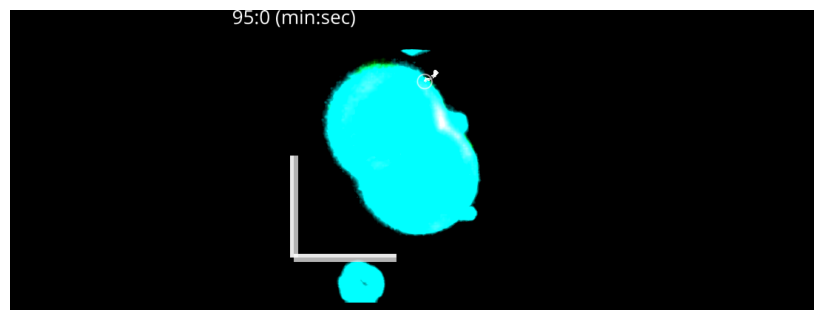

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

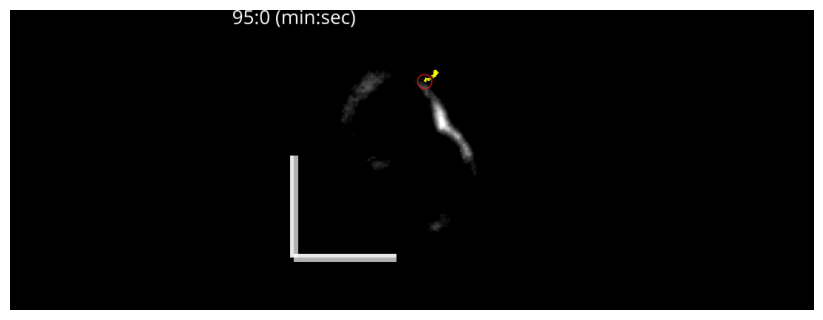

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

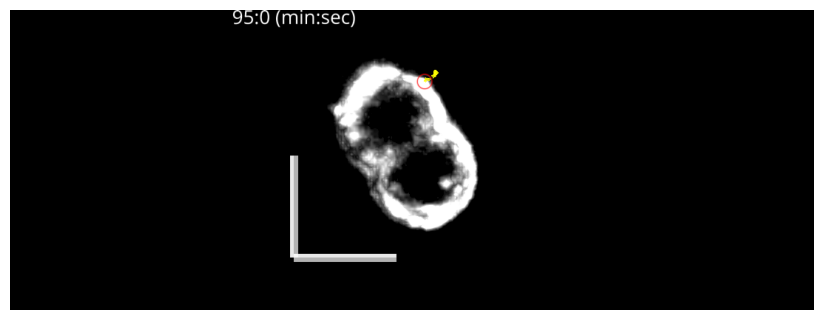

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

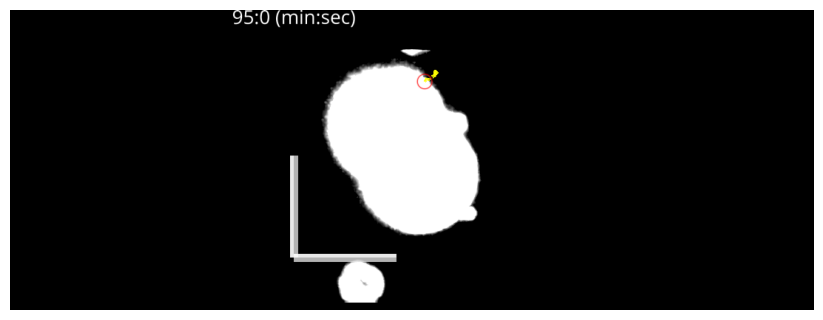

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

In [83]:
origin_z = vis_params['z_range'][0]
origin_y = micron_per_px*crop.shape[-2]
origin_x = 0
scale_origin=[origin_z,origin_y,origin_x]
scale_size=[-5,-5,5]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 488', 'Confocal 638'],
                   vis_params=vis_params, points=spots, traj=traj, z_low=18, z_high=40,
                   script='movies/s8_rotation_advannotated_movie_script.txt', 
                   movie_name='s8_rotation_spots_traj_movie_advannotated',
                   scale_bar=True, scale_origin=scale_origin, scale_size=scale_size,
                   timestamps=True, raw_stack=raw, s_timestamps=s_timestamps, 
                  close_window=False)

##### Read movies

In [ ]:
max_projections = {'Merge':skvideo.io.vread('movies/s5c_spots_movie_merge.mp4'),
                  'Confocal 561 2':skvideo.io.vread('movies/s5c_movie_Sac6-RFP.mp4'),
                  'Confocal 488':skvideo.io.vread('movies/s5c_movie_Bzz1-GFP.mp4'),
                  'Confocal 638':skvideo.io.vread('movies/s5c_movie_ATTO647-DOPE.mp4')}
max_projections['Merge'].shape

In [ ]:
all_frames = raw.metadata['frames']
s_per_frame = vis_params.loc['Confocal 561 2']['s_per_frame']
frames = all_frames[:29:3]
count = 0
width = 1.8*len(frames)
height = 0.8*width
channels = ['Merge','Confocal 638','Confocal 561 2','Confocal 488']

fig5 = plt.figure(figsize=(width, height), constrained_layout=False)
fig5.text(0.05,0.92,'A', fontsize=BIGGER_SIZE)
fig5.text(0.05,0.48,'B', fontsize=BIGGER_SIZE)
#fig5.text(0.52,0.48,'C', fontsize=BIGGER_SIZE)

# gridspec inside gridspec
outer_grid = fig5.add_gridspec(2, 1, wspace=0.3, hspace=0.2)

# panel A
inner_grid = outer_grid[0].subgridspec(len(channels),len(frames),
                                         wspace=0.0, hspace=0.0)
fig5.text(0.5,0.92,'Incubation time (minutes:seconds)',fontsize=MEDIUM_SIZE,ha='center')
for channel in channels:
    for tp in frames:
        ax = fig5.add_subplot(inner_grid[count])
        count += 1
        ax.imshow(max_projections[channel][tp,170:-620,540:-770])
        if channel == channels[0]:
            minutes = int(s_per_frame*tp//60)
            seconds = int(np.round((s_per_frame*tp/60-minutes)*60))
            plt.title(str(95+minutes)+':'+str(seconds))
        if tp == frames[0]:
            plt.ylabel(vis_params.loc[channel]['label'],
                       rotation=0,color=vis_params.loc[channel]['color'],
                       ha='right',)
        if count == len(frames)*len(channels):
            scalebar = ScaleBar(micron_per_px/10, 'um', box_alpha=0, color='w', 
                                length_fraction=0.4, height_fraction=0.02)
            plt.gca().add_artist(scalebar)
        ax.set_xticks([])
        ax.set_yticks([])
        fig5.add_subplot(ax)
        
# panel B
ax1 = fig5.add_subplot(outer_grid[1])
ax2 = ax1.twinx()
df = tracks_dict[track]
time = df['POSITION_T']/60
inflection = findInflectionPoint(time, df['DISPLACEMENT'])
time_aligned = time - inflection

incubation_time = time+95

ax1.plot(incubation_time, df['MEAN_INTENSITY01']/np.max(df['MEAN_INTENSITY01']), 
         color='magenta', label = 'Sac6-RFP')
ax1.plot(incubation_time, df['MEAN_INTENSITY02']/np.max(df['MEAN_INTENSITY02']), 
         color='green', label = 'Bzz1-GFP')
ax2.plot(incubation_time, df['DISPLACEMENT'],
         color = 'blue', label = 'Displacement')
plt.tick_params(labelcolor='blue')
plt.ylabel('Vesicle Displacement (µm)', color='blue')
ax1.vlines(incubation_time[inflection], 0, 1, linestyle='dashed', color = 'orange', label = 'Inflection point')
ax1.set(xlabel = 'Incubation time (minutes)', ylabel = 'Normalized Fluorescence Intensity')
#plt.xlim(left=90)
#ax1.legend(loc='lower right')
fig5.legend(loc='center right', bbox_to_anchor=(1,0.5), bbox_transform=ax1.transAxes)

plt.savefig('figures/figs5c.png')
plt.savefig('figures/figs5c.svg')

# Supplemental movies for vesicles embedded in actin

## Supplemental movie S3

### Set paths to data

In [ ]:
crop_tiff = 'data/20190509_4.2eB3_crop2.tif'
raw_nd2 = 'data/20190509_4.2eB3.nd2'

### Read processed single bead crop

In [ ]:
crop = io.imread(crop_tiff)
crop = crop[np.newaxis, ...]
crop.shape

### Read raw data corresponding to processed stack

In [ ]:
raw = ND2Reader(raw_nd2)
raw.bundle_axes = 'czyx'
raw

### Read metadata from raw data

In [ ]:
raw_metadata = nd2_metadata(raw)

In [ ]:
channel_names = {'sac6':'Confocal 561 2',
                'bzz1':'Confocal 488',
                'dope':'Confocal 638'}
contrast = {'sac6':(2030,8540),
            'bzz1':(300,3700),
            'dope':(750,2730)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
#labels = {'sac6':'Sac6-RFP',
#        'bzz1':'Bzz1-GFP',
#        'dope':'ATTO647-DOPE',
#         'merge':'Merge'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE'}

vis_params = pd.DataFrame({'channel':channel_names,
             'contrast':contrast,
             'color':colors,
             'label':labels}).set_index('channel')
channel_order = {'stack_index':{}}
for i, channel in enumerate(raw_metadata['channel']):
    channel_order['stack_index'][channel] = i

vis_params = pd.concat([vis_params,pd.DataFrame(channel_order),
                       pd.DataFrame(raw_metadata).set_index('channel')],axis=1)

# hack to add merge visualization
vpm = vis_params.loc[vis_params.index[0]].copy()
vpm['label'] = 'Merge'
vpm['color'] = 'black'
vis_params.loc['Merge'] = vpm

#vis_params.loc['Merge'] = vis_params.loc[vis_params.index[0]].copy()
#vis_params.loc['Merge']['color'] = 'black'
#vis_params.loc['Merge']['label'] = 'Merge'
vis_params

In [ ]:
# I couldn't work this one into the dataframe
num_frames = vis_params['num_frames'][0]
s_per_frame = vis_params['s_per_frame'][0]
s_timestamps = np.arange(num_frames)*s_per_frame

### Make movies/montages

##### write movie script

In [ ]:
rotation_frames = 250
with open("movies/rotation_movie_script.txt", "w") as text_file:
    print(
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)',
        file=text_file)

##### Record movies in napari

###### merge of sac6, bzz1, and lipid

In [ ]:
movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 638'],
         vis_params=vis_params,
        script='movies/rotation_movie_script.txt', 
         movie_name='supprotation1_movie')

###### merge of sac6, bzz1, and lipid with scale bar

In [ ]:
movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 638'],
         vis_params=vis_params,
        script='movies/rotation_movie_script.txt', 
         movie_name='supprotation1_movie_scalebar',
        scale_bar=True)

###### merge of sac6, bzz1, and lipid with scale bar

In [ ]:
t_px = 0
z_px = 8
y_px = 13
x_px = 4

z_micron = z_px/vis_params['z_spacing'][0]
y_micron = y_px/vis_params['micron_per_px'][0]
x_micron = x_px/vis_params['micron_per_px'][0]

spot = [t_px,z_micron,y_micron,x_micron]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 638'],
         vis_params=vis_params, points=spot,
        script='movies/rotation_movie_script.txt', 
         movie_name='supprotation1_movie_scalebar',
        scale_bar=True, points_size=10)

## Supplemental movie S4

### Set paths to data

In [ ]:
crop_tiff = 'data/20190509_4.2eB3003_crop1.tif'
raw_nd2 = 'data/20190509_4.2eB3003.nd2'

### Read processed single bead crop

In [ ]:
crop = io.imread(crop_tiff)
crop = crop[np.newaxis, ...]
crop.shape

### Read raw data corresponding to processed stack

In [ ]:
raw = ND2Reader(raw_nd2)
raw.bundle_axes = 'czyx'
raw

### Read metadata from raw data

In [ ]:
raw_metadata = nd2_metadata(raw)

In [ ]:
channel_names = {'sac6':'Confocal 561 2',
                'bzz1':'Confocal 488',
                'dope':'Confocal 638'}
contrast = {'sac6':(1500,8000),
            'bzz1':(300,3700),
            'dope':(1050,4000)}
colors = {'sac6':'magenta',
        'bzz1':'green',
        'dope':'cyan'}
#labels = {'sac6':'Sac6-RFP',
#        'bzz1':'Bzz1-GFP',
#        'dope':'ATTO647-DOPE',
#         'merge':'Merge'}
labels = {'sac6':'Sac6-RFP',
        'bzz1':'Bzz1-GFP',
        'dope':'ATTO647-DOPE'}

vis_params = pd.DataFrame({'channel':channel_names,
             'contrast':contrast,
             'color':colors,
             'label':labels}).set_index('channel')
channel_order = {'stack_index':{}}
for i, channel in enumerate(raw_metadata['channel']):
    channel_order['stack_index'][channel] = i

vis_params = pd.concat([vis_params,pd.DataFrame(channel_order),
                       pd.DataFrame(raw_metadata).set_index('channel')],axis=1)

# hack to add merge visualization
vpm = vis_params.loc[vis_params.index[0]].copy()
vpm['label'] = 'Merge'
vpm['color'] = 'black'
vis_params.loc['Merge'] = vpm

#vis_params.loc['Merge'] = vis_params.loc[vis_params.index[0]].copy()
#vis_params.loc['Merge']['color'] = 'black'
#vis_params.loc['Merge']['label'] = 'Merge'
vis_params

In [ ]:
# I couldn't work this one into the dataframe
num_frames = vis_params['num_frames'][0]
s_per_frame = vis_params['s_per_frame'][0]
s_timestamps = np.arange(num_frames)*s_per_frame

### Make movies/montages

##### write movie script

In [ ]:
rotation_frames = 250
with open("movies/rotation_movie_script.txt", "w") as text_file:
    print(
f'From frame 0 to frame {rotation_frames} rotate by 360 degrees around (0,0,1)',
        file=text_file)

##### Record movies in napari

###### merge of sac6, bzz1, and lipid

In [ ]:
movie_3d(stack=crop, channels_list=['Confocal 561 2', 'Confocal 638'],
         vis_params=vis_params,
        script='movies/rotation_movie_script.txt', 
         movie_name='supprotation2_movie')

###### merge of sac6, bzz1, and lipid with scale bar

In [ ]:
t_px = 0
z_px = 2.5
y_px = 20.2
x_px = 6.5

z_micron = z_px/vis_params['z_spacing'][0]
y_micron = y_px/vis_params['micron_per_px'][0]
x_micron = x_px/vis_params['micron_per_px'][0]

spot = [t_px,z_micron,y_micron,x_micron]

movie_3d_annotated(stack=crop, channels_list=['Confocal 561 2', 'Confocal 638'],
         vis_params=vis_params, points=spot,
        script='movies/rotation_movie_script.txt', 
         movie_name='supprotation2_movie_scalebar',
        scale_bar=True, points_size=10)

# Supplemental movie showing actin tail (Movie S1)

### Set paths to data

In [9]:
crop_tiff = 'data/S1_shapecrop.tif'

### Read processed single bead crop

In [10]:
crop = io.imread(crop_tiff)
crop = crop[np.newaxis, ...]
crop.shape

(1, 38, 63, 129)

### Set metadata

In [11]:
### Make movies/montages

### Make movies/montages

#### Record movie in napari

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari\utils\events\event.py:285: RuntimeWarning: coroutine 'get_msg' was never awaited
  self._callback_refs: List[Optional[str]] = []
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  command_list = np.array(command_list)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:193: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to

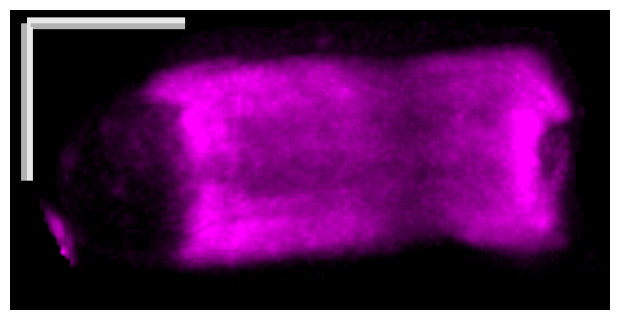

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

In [17]:
viewer = napari.Viewer(ndisplay=3)
                 
viewer.add_image(crop, colormap='magenta', 
                 scale=[1,0.25,0.14,0.14], contrast_limits=(1400,5500), blending='additive')

add_scale_3d(viewer, origin=[0,0,0])

movie = Movie(myviewer=viewer)
movie.create_state_dict_from_script('movies/rotation_movie_script.txt')
movie.make_movie(name = 'movies/S1_merge.mp4',
             resolution = 320, fps = 20)

#### Record movie with bead outline in napari

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  command_list = np.array(command_list)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\scriptcommands.py:193: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  current_state = copy.deepcopy(movie.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\numpy\core\fromnumeric.py:86: Visible

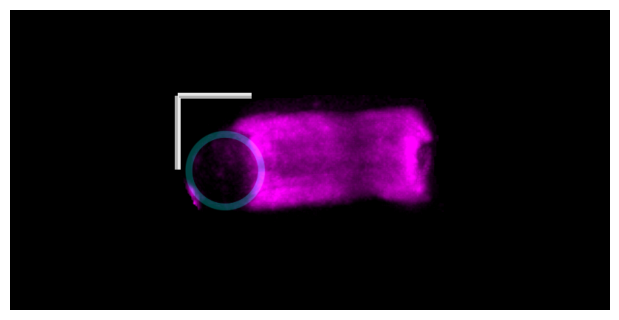

C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:269: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  new_state = copy.deepcopy(self.myviewer.window.qt_viewer.view.camera.get_state())
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\naparimovie\naparimovie.py:283: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.myviewer.window.qt_viewer.view.camera.set_state(new_state)
C:\Users\Nice\miniconda3\envs\reconstitution_analysis\lib\site-packages\napari

In [26]:
viewer = napari.Viewer(ndisplay=3)
   
viewer.add_image(crop, colormap='magenta', 
                 scale=[1,0.25,0.14,0.14], contrast_limits=(1400,5500), blending='additive')
add_scale_3d(viewer, origin=[0,0,0])
viewer.add_points(np.array([[ 0.        , 12.        , 36.13622617, 23.0136256 ]]),
                 symbol='disc', size=np.array([[35, 35, 35, 35]]),
                 edge_color=np.array([[0., 1., 1., 1.]]),
                 face_color=np.array([[0., 0., 0., 0.]]),
                 scale=np.array([1.  , 0.25, 0.14, 0.14]),
                 opacity=0.25, blending='additive', name='bead')
viewer.camera.zoom=20


movie = Movie(myviewer=viewer)
movie.create_state_dict_from_script('movies/rotation_movie_script.txt')
movie.make_movie(name = 'movies/S1_beadoutline.mp4',
             resolution = 320, fps = 20)

# Figure 4E: plotting EM quantification

In [16]:
clem_counts = pd.read_csv('./data/clem_bilayer_counting.csv', index_col=0)
clem_counts

,description,n beads,within 100 nm total,within 100 nm,beyond 100 nm total,100 to 1000 nm
sample id,,,,,,
1,- scWASP - LatA + extract,47,3,0.063830,2,0.042553
2,+ scWASP - LatA + extract,51,11,0.215686,32,0.627451
3,+ scWASP + LatA + extract,43,36,0.837209,7,0.162791
4,+ scWASP - LatA - extract,16,0,0.000000,0,0.000000


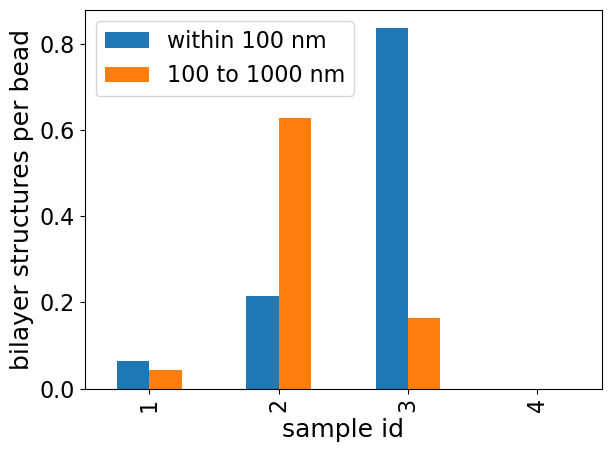

In [18]:
clem_counts[['within 100 nm','100 to 1000 nm']].plot(kind='bar', ylabel='bilayer structures per bead')
plt.tight_layout()
plt.savefig('figures/clem_bilayer_counts.svg')
plt.savefig('figures/clem_bilayer_counts.png')

In [ ]:
backfill